In [1]:
!pip install git+https://github.com/mlfoundations/open_clip.git
!pip install faiss-cpu

  Cloning https://github.com/mlfoundations/open_clip.git to /tmp/pip-req-build-v6jplwki
  Running command git clone --filter=blob:none --quiet https://github.com/mlfoundations/open_clip.git /tmp/pip-req-build-v6jplwki
  Resolved https://github.com/mlfoundations/open_clip.git to commit 223afc46ac549f9e86e5cde17a1e476631d1d58f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 51.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 21.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 11.

In [2]:
import os

In [3]:
ROOT_PATH = "/kaggle/input"
DATA_PATH = os.path.join(ROOT_PATH, "entrep-acmmm")

In [4]:
# !unzip "$DATA_PATH/Dataset.zip" -d "$DATA_PATH"

In [5]:
import json

TRAIN_PATH = os.path.join(DATA_PATH, "train/train")

with open(os.path.join(TRAIN_PATH, "cls.json")) as f:
  cls_data = json.load(f)

with open(os.path.join(TRAIN_PATH, "t2i.json")) as f:
  t2i_data = json.load(f)

with open(os.path.join(TRAIN_PATH, "i2i.json")) as f:
  i2i_data = json.load(f)
    
with open(os.path.join(DATA_PATH, "Dataset/data.json")) as f:
  data = json.load(f)

print(data[0])
print(data[0].keys())

{'Path': '17089462_231004112419923831_954_image05.png', 'Classification': 'vc-open', 'Type': 'abnormal', 'Description': 'thành sau họng đọng dịch nhầy\r\nsụn phễu phù nề sung huyết\r\nquá phát mép sau\r\ndây thanh 2 bên phù nề\r\nxóa thanh thất', 'DescriptionEN': 'white discharge on the posterior wall of the pharynx\r\nedema and erythema of the arytenoid cartilages\r\nposterior commissure hypertrophy\r\nvocal cords are edematous\r\nventricular obliteration'}
dict_keys(['Path', 'Classification', 'Type', 'Description', 'DescriptionEN'])


In [6]:
import json
from collections import Counter

# Extract values from the "Classification" key
classifications = [item['Classification'] for item in data if 'Classification' in item]

# Count the occurrences
public_release_counts = Counter(classifications)

# Print the result
print(public_release_counts)

Counter({'nose-left': 180, 'nose-right': 128, 'vc-open': 80, 'vc-closed': 62, 'ear-left': 45, 'ear-right': 44, 'throat': 27})


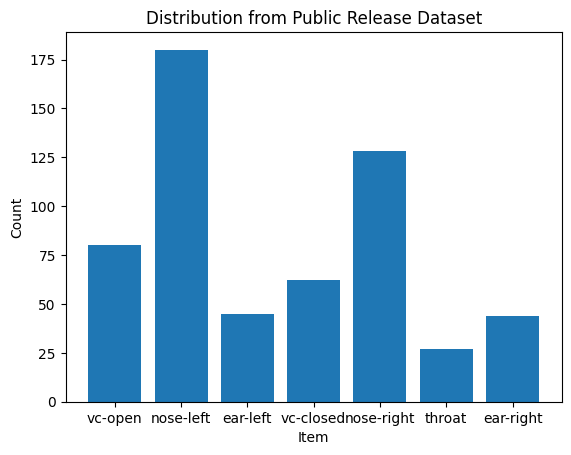

In [7]:
from collections import Counter
import matplotlib.pyplot as plt

# Plot
labels, values = zip(*public_release_counts .items())
plt.bar(labels, values)
plt.xlabel('Item')
plt.ylabel('Count')
plt.title('Distribution from Public Release Dataset')
plt.show()

In [8]:
import json
from collections import Counter

# Extract values from the "Classification" key
classifications = list(cls_data.values())

# Count the occurrences
public_contest_counts = Counter(classifications)

# Print the result
print(public_contest_counts)

Counter({'nose-right': 325, 'nose-left': 290, 'vc-open': 159, 'ear-right': 156, 'vc-closed': 147, 'ear-left': 133, 'throat': 81})


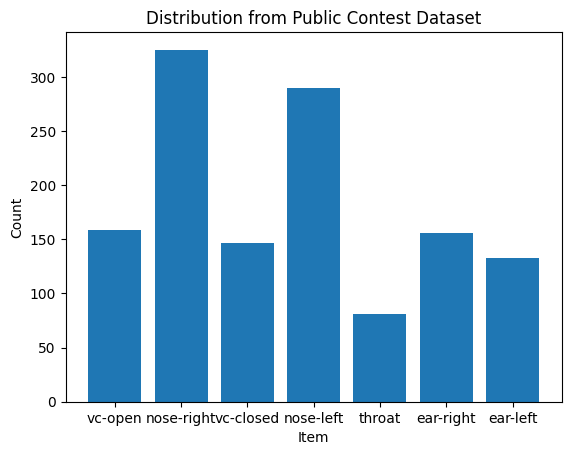

In [9]:
from collections import Counter
import matplotlib.pyplot as plt

# Plot
labels, values = zip(*public_contest_counts.items())
plt.bar(labels, values)
plt.xlabel('Item')
plt.ylabel('Count')
plt.title('Distribution from Public Contest Dataset')
plt.show()

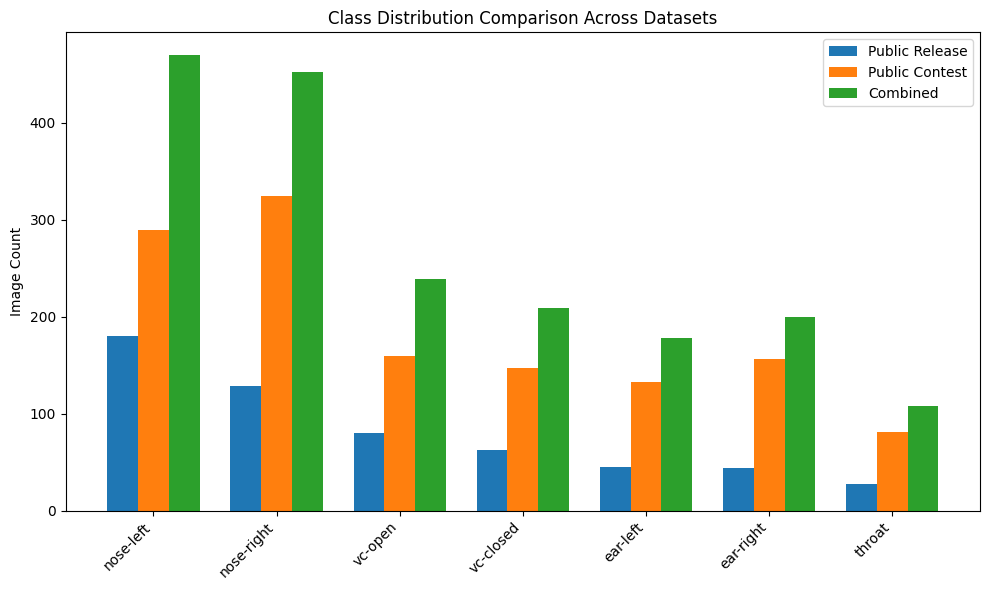

In [10]:
# Create combined counts
combined_counts = Counter(public_release_counts) + Counter(public_contest_counts)

# Ensure consistent ordering
classes = ['nose-left', 'nose-right', 'vc-open', 'vc-closed', 'ear-left', 'ear-right', 'throat']
release_vals = [public_release_counts.get(cls, 0) for cls in classes]
contest_vals = [public_contest_counts.get(cls, 0) for cls in classes]
combined_vals = [combined_counts.get(cls, 0) for cls in classes]

# Plotting
x = range(len(classes))
width = 0.25

fig, ax = plt.subplots(figsize=(10, 6))

# Plot each bar group
ax.bar([i - width for i in x], release_vals, width=width, label='Public Release', color='tab:blue')
ax.bar(x, contest_vals, width=width, label='Public Contest', color='tab:orange')
ax.bar([i + width for i in x], combined_vals, width=width, label='Combined', color='tab:green')

# Axis setup
ax.set_xticks(x)
ax.set_xticklabels(classes, rotation=45, ha='right')
ax.set_ylabel('Image Count')
ax.set_title('Class Distribution Comparison Across Datasets')
ax.legend()

plt.tight_layout()
plt.show()

vc-open


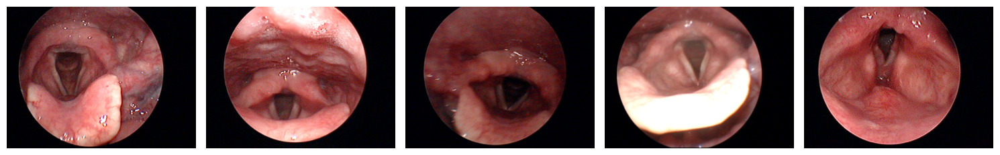

nose-left


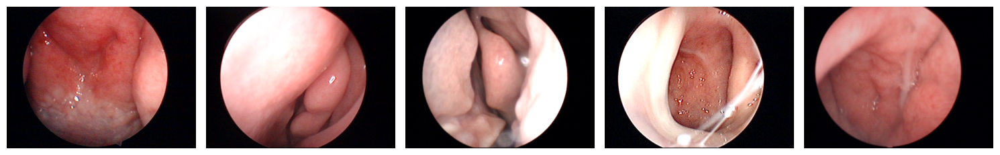

ear-left


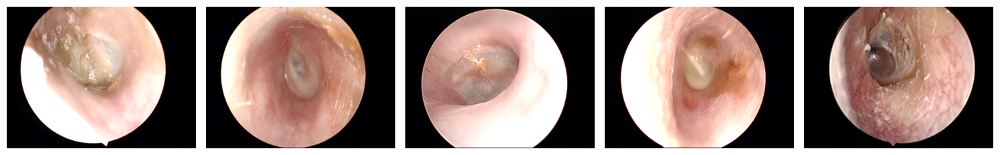

vc-closed


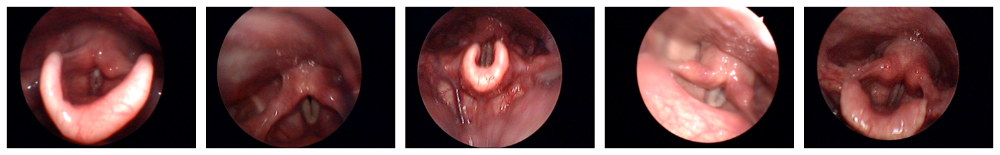

nose-right


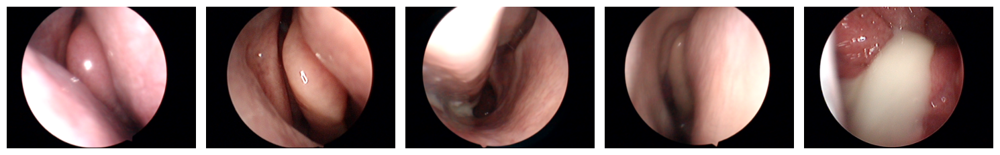

throat


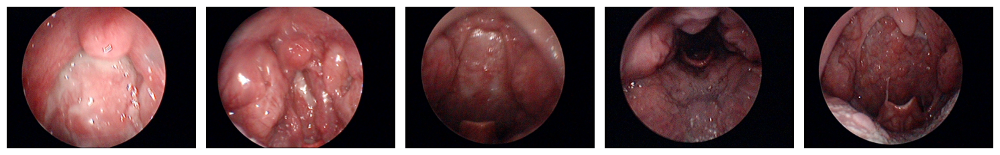

ear-right


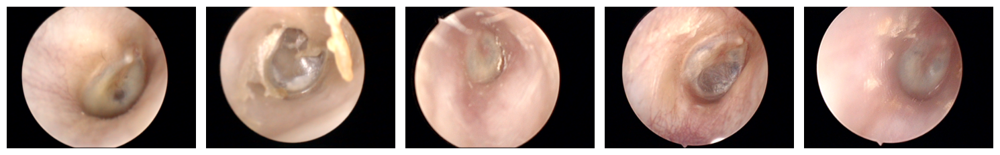

In [11]:
import json
import random
from collections import defaultdict, Counter
import matplotlib.pyplot as plt
from PIL import Image

# Group image paths by class
class_to_paths = defaultdict(list)
for item in data:
    if 'Classification' in item and 'Path' in item:
        class_to_paths[item['Classification']].append(item['Path'])

# Sample 5 images per class
sampled_images = {
    cls: random.sample(paths, min(5, len(paths)))
    for cls, paths in class_to_paths.items()
}

# Plotting
for cls, paths in sampled_images.items():
    print(cls)
    plt.figure(figsize=(15, 3))
    for i, img_path in enumerate(paths):
        try:
            img_path = img_path.replace("image", "Image")
            img = Image.open(os.path.join(DATA_PATH, "Dataset/images", img_path))
            plt.subplot(1, 5, i + 1)
            plt.imshow(img)
            plt.axis('off')
            # plt.title(f"{cls}", fontsize=10)
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
    # plt.suptitle(f"Class: {cls} — Showing {len(paths)} Sample(s)", fontsize=14)
    plt.tight_layout()
    plt.show()

vc-open


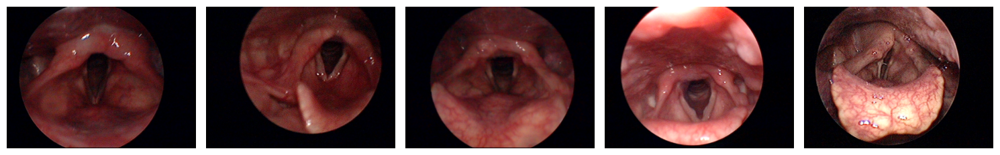

nose-right


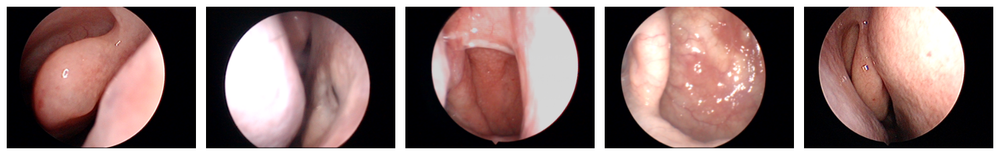

vc-closed


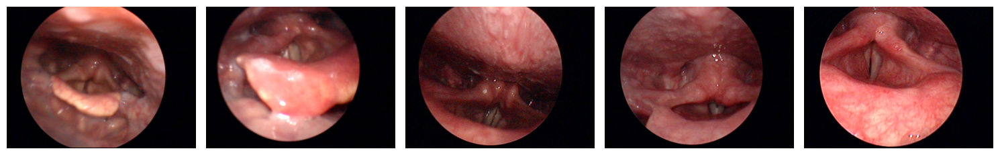

nose-left


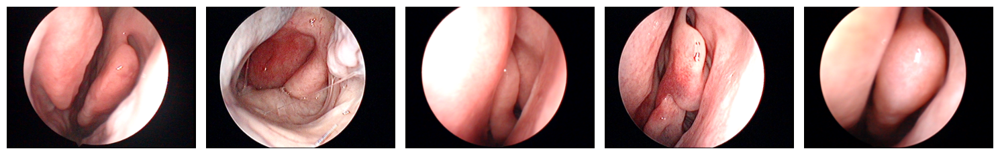

throat


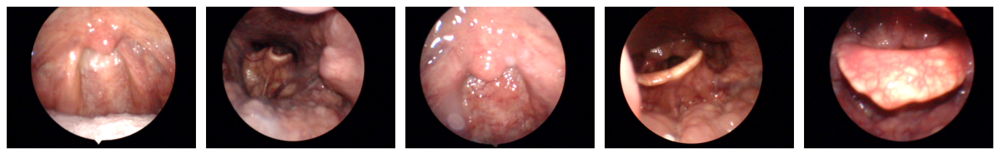

ear-right


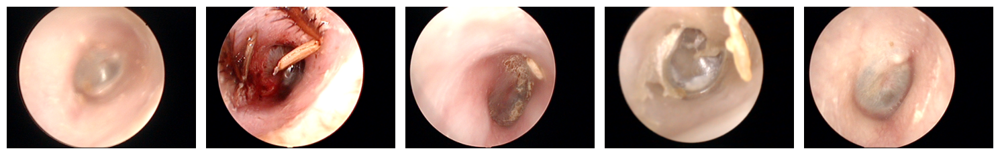

ear-left


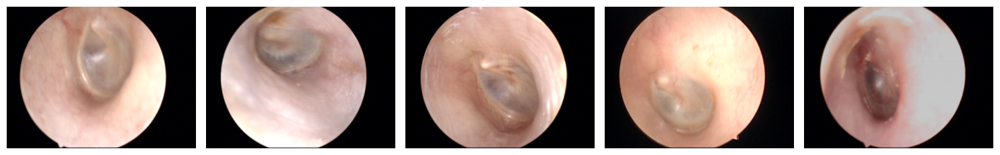

In [12]:
import json
import random
from collections import defaultdict, Counter
import matplotlib.pyplot as plt
from PIL import Image

# Group image paths by class
class_to_paths = defaultdict(list)
for key, value in cls_data.items():
        class_to_paths[value].append(key)

# Sample 5 images per class
sampled_images = {
    cls: random.sample(paths, min(5, len(paths)))
    for cls, paths in class_to_paths.items()
}

# Plotting
for cls, paths in sampled_images.items():
    print(cls)
    plt.figure(figsize=(15, 3))
    for i, img_path in enumerate(paths):
        try:
            img_path = img_path.replace("image", "Image")
            img = Image.open(os.path.join(DATA_PATH, "train/train/imgs", img_path))
            plt.subplot(1, 5, i + 1)
            plt.imshow(img)
            plt.axis('off')
            # plt.title(f"{cls}", fontsize=10)
        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
    # plt.suptitle(f"Class: {cls} — Showing {len(paths)} Sample(s)", fontsize=14)
    plt.tight_layout()
    plt.show()

In [13]:
import pandas as pd

df_1 = pd.read_json(os.path.join(DATA_PATH, "Dataset", "data.json"))
df_1["Path"] = df_1["Path"].apply(lambda x: os.path.join("Dataset/images", x.replace("image", "Image")))
image_to_text = {v: k for k, v in t2i_data.items()}

fallback_descriptions = {
    "nose-left": "An endoscopic image of the left nasal passage.",
    "nose-right": "An endoscopic image of the right nasal passage.",
    "ear-left": "An endoscopic image of the left ear.",
    "ear-right": "An endoscopic image of the right ear.",
    "vc-open": "An endoscopic image of the vocal cords in the open state.",
    "vc-closed": "An endoscopic image of the vocal cords in the closed state.",
    "throat": "An endoscopic image of the throat region."
}

# df_1["DescriptionEN"] = df_1.apply(
#     lambda row: fallback_descriptions.get(row["Classification"], "") + " " + (row["DescriptionEN"] or ""),
#     axis=1
# )

rows = []
for key, value in cls_data.items():
    description = image_to_text.get(key)
    if description is None:
        description = fallback_descriptions.get(value, None)

    rows.append({
        "Path": os.path.join("train/train/imgs", key),
        "Classification": value,
        "DescriptionEN": None,
        "Type": "abnormal",
        "Description": None
    })

# Create df_2 from rows, using df_1's column order
df_2 = pd.DataFrame(rows)[df_1.columns]
df = pd.concat([df_1, df_2], ignore_index=True)
df.head()

,Path,Classification,Type,Description,DescriptionEN
0,Dataset/images/17089462_231004112419923831_954...,vc-open,abnormal,thành sau họng đọng dịch nhầy\r\nsụn phễu phù ...,white discharge on the posterior wall of the p...
1,Dataset/images/17090495_230727104701590831_954...,nose-left,abnormal,vẹo vách ngăn phần cao\r\nniêm mạc cuốn giữa t...,superior septal deviation\r\npolypoid degenera...
2,Dataset/images/17090495_230727104701590831_954...,nose-left,abnormal,mào vách ngăn,a spur on the septum
3,Dataset/images/17092118_231121081438130831_954...,ear-left,abnormal,"màng nhĩ nguyên vẹn, tam giác sáng còn, màng n...","the tympanic membrane is intact, the cone of l..."
4,Dataset/images/17092946_230330075548499831_954...,vc-closed,abnormal,sụn phễu phù nề sung huyết,edema and erythema of the arytenoid cartilages


In [14]:
for i, row in df.head(10).iterrows():
    print("Row index", i)
    print("Vietnamese:")
    print(row['Description'])
    print("English:")
    print(row['DescriptionEN'])
    print('=' * 30)

Row index 0
Vietnamese:
thành sau họng đọng dịch nhầy
sụn phễu phù nề sung huyết
quá phát mép sau
dây thanh 2 bên phù nề
xóa thanh thất
English:
white discharge on the posterior wall of the pharynx
edema and erythema of the arytenoid cartilages
posterior commissure hypertrophy
vocal cords are edematous
ventricular obliteration
Row index 1
Vietnamese:
vẹo vách ngăn phần cao
niêm mạc cuốn giữa thoái hóa polyp
English:
superior septal deviation
polypoid degeneration of the middle turbinate
Row index 2
Vietnamese:
mào vách ngăn
English:
a spur on the septum
Row index 3
Vietnamese:
màng nhĩ nguyên vẹn, tam giác sáng còn, màng nhĩ dày ở phần sau và phần dưới
English:
the tympanic membrane is intact, the cone of light is visualized, the tympanic membrane is thickened posteriorly and inferiorly
Row index 4
Vietnamese:
sụn phễu phù nề sung huyết 
English:
edema and erythema of the arytenoid cartilages
Row index 5
Vietnamese:
sụn phễu phù nề sung huyết
English:
edema and erythema of the arytenoi

In [15]:
import os
import random
import numpy as np
import torch

def set_all_seeds(seed):
  random.seed(seed)
  np.random.seed(seed)
  torch.manual_seed(seed)
  torch.cuda.manual_seed(seed)
  torch.backends.cudnn.deterministic = True

SEED = 42
set_all_seeds(SEED)

In [16]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Merge similar classes
coarse_classes = {
    'nose-left': 'nose',
    'nose-right': 'nose',
    'ear-left': 'ear',
    'ear-right': 'ear',
    'vc-open': 'vc',
    'vc-closed': 'vc',
}

df['Coarse_Classification'] = df['Classification'].replace(coarse_classes)

# Initial split: 80% train, 20% temp
df_train, df_temp = train_test_split(
    df,
    test_size=0.2,
    stratify=df['Classification'],
    random_state=42
)

# Split the 20% temp into 10% val, 10% test
df_val, df_test = train_test_split(
    df_temp,
    test_size=0.5,
    stratify=df_temp['Classification'],
    random_state=42
)

# Print distribution
print("Train:", df_train['Classification'].value_counts())
print("Val:  ", df_val['Classification'].value_counts())
print("Test: ", df_test['Classification'].value_counts())
print("Train:", df_train['Coarse_Classification'].value_counts())
print("Val:  ", df_val['Coarse_Classification'].value_counts())
print("Test: ", df_test['Coarse_Classification'].value_counts())

Train: Classification
nose-left     376
nose-right    362
vc-open       191
vc-closed     167
ear-right     160
ear-left      142
throat         87
Name: count, dtype: int64
Val:   Classification
nose-left     47
nose-right    45
vc-open       24
vc-closed     21
ear-right     20
ear-left      18
throat        11
Name: count, dtype: int64
Test:  Classification
nose-left     47
nose-right    46
vc-open       24
vc-closed     21
ear-right     20
ear-left      18
throat        10
Name: count, dtype: int64
Train: Coarse_Classification
nose      738
vc        358
ear       302
throat     87
Name: count, dtype: int64
Val:   Coarse_Classification
nose      92
vc        45
ear       38
throat    11
Name: count, dtype: int64
Test:  Coarse_Classification
nose      93
vc        45
ear       38
throat    10
Name: count, dtype: int64


In [17]:
import os
import torch
import numpy as np
import faiss
import pandas as pd
from PIL import Image
from tqdm import tqdm
import open_clip

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

clip_model_name = "hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224"
model, _, preprocess = open_clip.create_model_and_transforms(clip_model_name)
tokenizer = open_clip.get_tokenizer(clip_model_name)
model = model.to(device).eval()

def get_combined_embedding(row, include_text=False):
    # Image
    img_path = os.path.join(DATA_PATH, row["Path"])
    img = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)

    if include_text:
        text = row["DescriptionEN"] if isinstance(row["DescriptionEN"], str) else ""
        text_tokens = tokenizer([text]).to(device)

        with torch.no_grad(), torch.cuda.amp.autocast():
            img_emb = model.encode_image(img)
            txt_emb = model.encode_text(text_tokens)
    
        sim = torch.nn.functional.cosine_similarity(img_emb, txt_emb, dim=1)
        combined_emb = img_emb * sim.unsqueeze(1) + txt_emb * (1 - sim.unsqueeze(1))
        combined_emb = combined_emb.squeeze(0).cpu().numpy()

        return combined_emb
    else:
        with torch.no_grad(), torch.cuda.amp.autocast():
            img_emb = model.encode_image(img)
        
        return img_emb.squeeze(0).cpu().numpy()

from collections import defaultdict
prototypes = defaultdict(list)

df_combined = pd.concat([df_train, df_val], ignore_index=True)

print("Computing combined embeddings for train set...")
for _, row in tqdm(df_combined.iterrows(), total=len(df_combined)):
    emb = get_combined_embedding(row, include_text=True)
    prototypes[row["Classification"]].append(emb)

# Compute class prototypes by averaging embeddings
class_names = sorted(prototypes.keys())
proto_mat = []
for cls in class_names:
    proto = np.mean(prototypes[cls], axis=0)
    proto_mat.append(proto)
proto_mat = np.vstack(proto_mat).astype('float32')

# Normalize for cosine similarity in FAISS
faiss.normalize_L2(proto_mat)

# Build FAISS index
index = faiss.IndexFlatIP(proto_mat.shape[1])
index.add(proto_mat)

# Classify test set
y_true = []
y_pred = []

print("Classifying test set using nearest prototype...")
for _, row in tqdm(df_test.iterrows(), total=len(df_test)):
    emb = get_combined_embedding(row, include_text=False).astype('float32')
    faiss.normalize_L2(emb.reshape(1, -1))
    D, I = index.search(emb.reshape(1, -1), 1)
    pred_class = class_names[I[0][0]]
    y_true.append(row["Classification"])
    y_pred.append(pred_class)

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
acc = accuracy_score(y_true, y_pred)
print(f"\n📊 Prototype Classification Accuracy (BiomedCLIP + FAISS): {acc:.4f}")
print(classification_report(y_true, y_pred, digits=4))

open_clip_config.json:   0%|          | 0.00/707 [00:00<?, ?B/s]

open_clip_pytorch_model.bin:   0%|          | 0.00/784M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

2025-07-28 12:47:24.459323: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1753706844.692524      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1753706844.765303      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


tokenizer_config.json:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

Computing combined embeddings for train set...


  0%|          | 0/1671 [00:00<?, ?it/s]/tmp/ipykernel_19/2730996260.py:26: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 1671/1671 [01:14<00:00, 22.37it/s]


Classifying test set using nearest prototype...


  0%|          | 0/186 [00:00<?, ?it/s]/tmp/ipykernel_19/2730996260.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 186/186 [00:05<00:00, 31.78it/s]


📊 Prototype Classification Accuracy (BiomedCLIP + FAISS): 0.5591
              precision    recall  f1-score   support

    ear-left     0.5385    0.7778    0.6364        18
   ear-right     0.6923    0.4500    0.5455        20
   nose-left     0.5000    0.7021    0.5841        47
  nose-right     0.4500    0.1957    0.2727        46
      throat     0.5000    0.8000    0.6154        10
   vc-closed     0.6087    0.6667    0.6364        21
     vc-open     0.7727    0.7083    0.7391        24

    accuracy                         0.5591       186
   macro avg     0.5803    0.6144    0.5756       186
weighted avg     0.5595    0.5591    0.5356       186



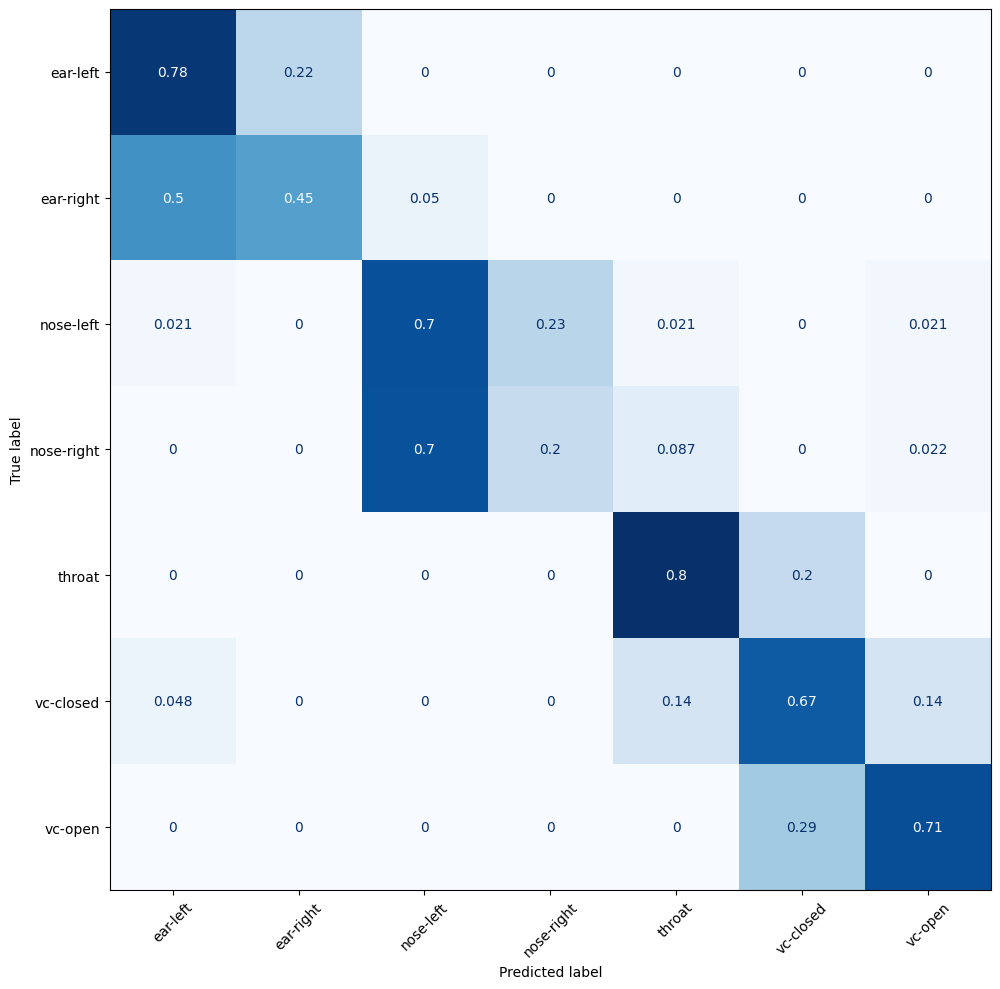

In [18]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Assuming you have already computed y_true and y_pred
# Compute and plot confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=class_names, normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
fig, ax = plt.subplots(figsize=(12, 10))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
# plt.title("Confusion Matrix: BiomedCLIP + FAISS")
ax.grid(False)
plt.tight_layout()
plt.show()

Computing BiomedCLIP embeddings for visualization...


  0%|          | 0/1671 [00:00<?, ?it/s]/tmp/ipykernel_19/2730996260.py:26: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 1671/1671 [01:01<00:00, 26.96it/s]


Reducing dimensionality with t-SNE...


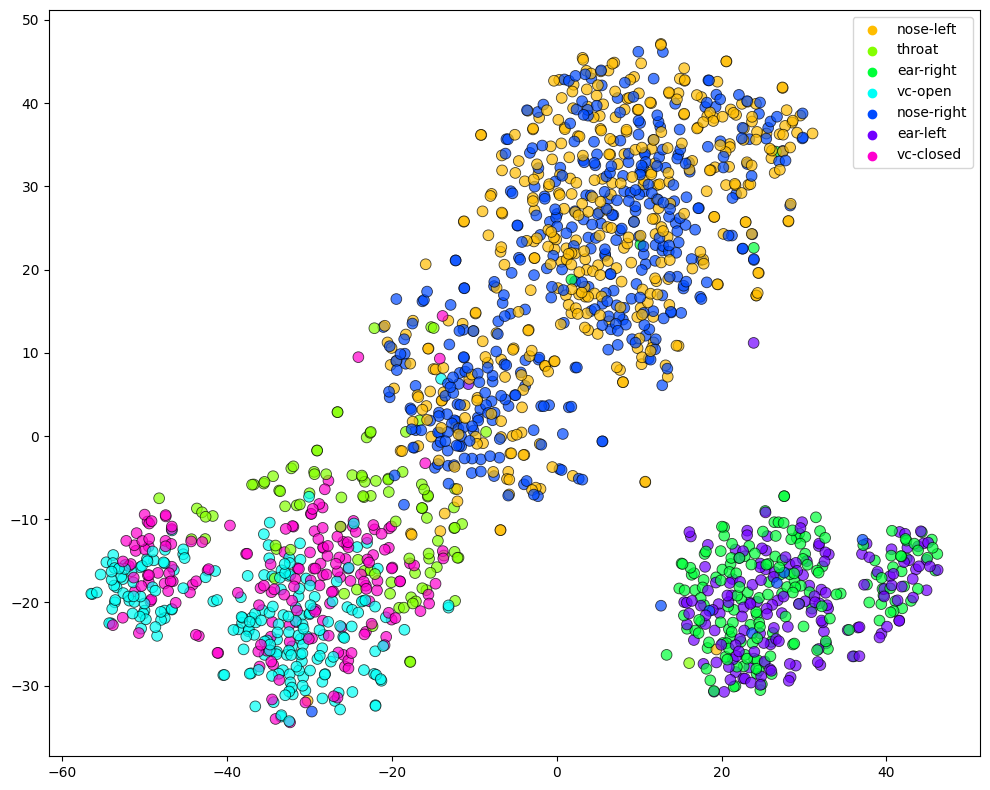

In [19]:
import pandas as pd
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import numpy as np

embeddings = []
labels = []


print("Computing BiomedCLIP embeddings for visualization...")
for _, row in tqdm(df_combined.iterrows(), total=len(df_combined)):
    try:
        emb = get_combined_embedding(row, include_text=True)
        embeddings.append(emb)
        labels.append(row["Classification"])
    except Exception as e:
        print(f"Skipped {row['Path']} due to error: {e}")

embeddings = np.vstack(embeddings)
labels = np.array(labels)

# Dimensionality reduction
print("Reducing dimensionality with t-SNE...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
embeddings_2d = tsne.fit_transform(embeddings)

# Encode labels for coloring
le = LabelEncoder()
labels_encoded = le.fit_transform(labels)

# Plot
plt.figure(figsize=(10, 8))
palette = sns.color_palette("hsv", len(np.unique(labels)))
sns.scatterplot(x=embeddings_2d[:, 0], y=embeddings_2d[:, 1],
                hue=labels, palette=palette, s=60, alpha=0.7, edgecolor="k")
# plt.title("BiomedCLIP Embeddings (Train) Projected via t-SNE")
plt.legend(loc="best", bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()

In [20]:
import gc
import torch

gc.collect()
torch.cuda.empty_cache()

In [21]:
import os
import torch
import numpy as np
import faiss
import pandas as pd
from PIL import Image
from tqdm import tqdm
import open_clip

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

clip_model_name = "hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224"
model, _, preprocess = open_clip.create_model_and_transforms(clip_model_name)
tokenizer = open_clip.get_tokenizer(clip_model_name)
model = model.to(device).eval()

def get_combined_embedding(row, include_text=False):
    # Image
    img_path = os.path.join(DATA_PATH, row["Path"])
    img = preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)

    if include_text:
        text = row["DescriptionEN"] if isinstance(row["DescriptionEN"], str) else ""
        text_tokens = tokenizer([text]).to(device)

        with torch.no_grad(), torch.cuda.amp.autocast():
            img_emb = model.encode_image(img)
            txt_emb = model.encode_text(text_tokens)
    
        sim = torch.nn.functional.cosine_similarity(img_emb, txt_emb, dim=1)
        combined_emb = img_emb * sim.unsqueeze(1) + txt_emb * (1 - sim.unsqueeze(1))
        combined_emb = combined_emb.squeeze(0).cpu().numpy()

        return combined_emb
    else:
        with torch.no_grad(), torch.cuda.amp.autocast():
            img_emb = model.encode_image(img)
        
        return img_emb.squeeze(0).cpu().numpy()

from collections import defaultdict
prototypes = defaultdict(list)

df_combined = pd.concat([df_train, df_val], ignore_index=True)
print("Computing combined embeddings for train set...")
for _, row in tqdm(df_combined.iterrows(), total=len(df_combined)):
    emb = get_combined_embedding(row, include_text=True)
    prototypes[row["Coarse_Classification"]].append(emb)

# Compute class prototypes by averaging embeddings
class_names = sorted(prototypes.keys())
proto_mat = []
for cls in class_names:
    proto = np.mean(prototypes[cls], axis=0)
    proto_mat.append(proto)
proto_mat = np.vstack(proto_mat).astype('float32')

# Normalize for cosine similarity in FAISS
faiss.normalize_L2(proto_mat)

# Build FAISS index
index = faiss.IndexFlatIP(proto_mat.shape[1])
index.add(proto_mat)

# Classify test set
y_true = []
y_pred = []

print("Classifying test set using nearest prototype...")
for _, row in tqdm(df_test.iterrows(), total=len(df_test)):
    emb = get_combined_embedding(row, include_text=False).astype('float32')
    faiss.normalize_L2(emb.reshape(1, -1))
    D, I = index.search(emb.reshape(1, -1), 1)
    pred_class = class_names[I[0][0]]
    y_true.append(row["Coarse_Classification"])
    y_pred.append(pred_class)

from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
acc = accuracy_score(y_true, y_pred)
print(f"\n📊 Prototype Classification Accuracy (BiomedCLIP + FAISS): {acc:.4f}")
print(classification_report(y_true, y_pred, digits=4))

Computing combined embeddings for train set...


  0%|          | 0/1671 [00:00<?, ?it/s]/tmp/ipykernel_19/4062832939.py:26: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 1671/1671 [01:01<00:00, 26.95it/s]


Classifying test set using nearest prototype...


  0%|          | 0/186 [00:00<?, ?it/s]/tmp/ipykernel_19/4062832939.py:36: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 186/186 [00:04<00:00, 41.55it/s]


📊 Prototype Classification Accuracy (BiomedCLIP + FAISS): 0.9086
              precision    recall  f1-score   support

         ear     0.9487    0.9737    0.9610        38
        nose     0.9884    0.9140    0.9497        93
      throat     0.4545    1.0000    0.6250        10
          vc     0.9487    0.8222    0.8810        45

    accuracy                         0.9086       186
   macro avg     0.8351    0.9275    0.8542       186
weighted avg     0.9420    0.9086    0.9179       186



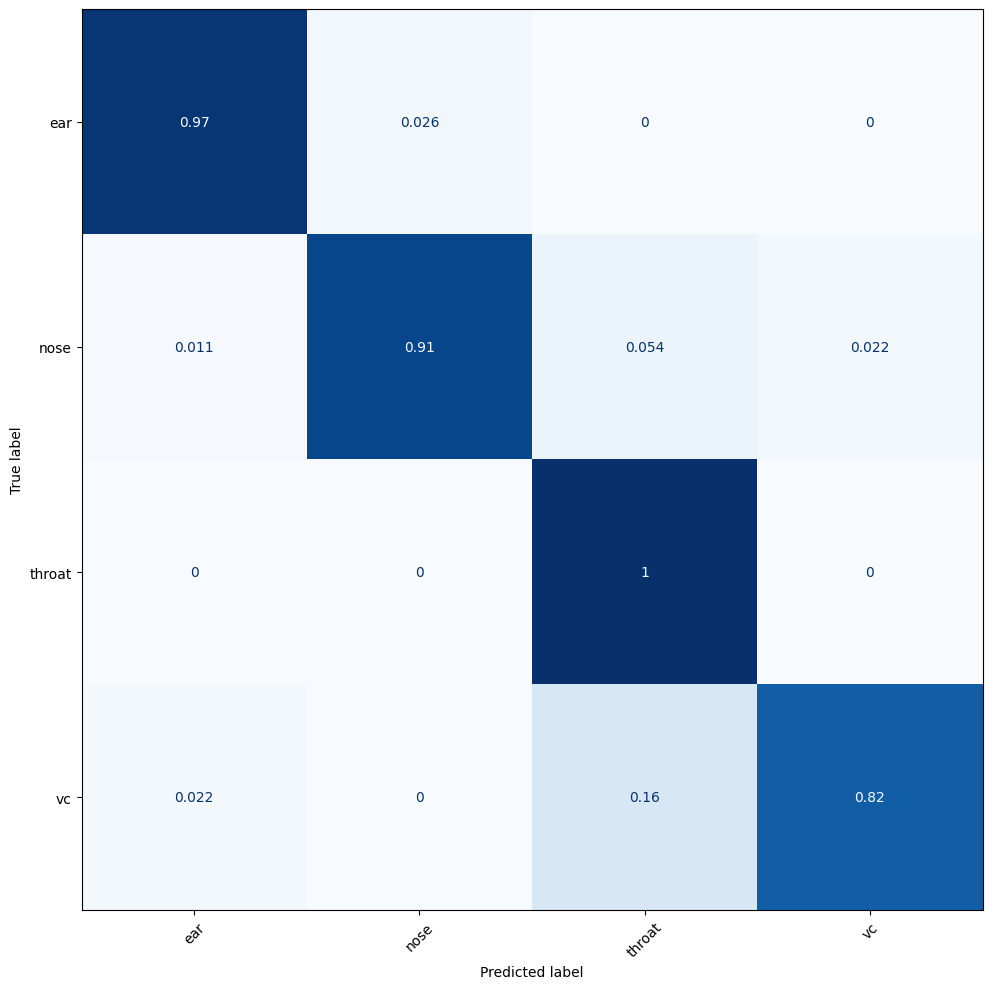

In [22]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Assuming you have already computed y_true and y_pred
# Compute and plot confusion matrix
cm = confusion_matrix(y_true, y_pred, labels=class_names, normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
fig, ax = plt.subplots(figsize=(12, 10))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
# plt.title("Confusion Matrix: BiomedCLIP + FAISS")
ax.grid(False)
plt.tight_layout()
plt.show()


Computing BiomedCLIP embeddings for visualization...


  0%|          | 0/1671 [00:00<?, ?it/s]/tmp/ipykernel_19/4062832939.py:26: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 1671/1671 [01:01<00:00, 27.03it/s]


Reducing dimensionality with t-SNE...


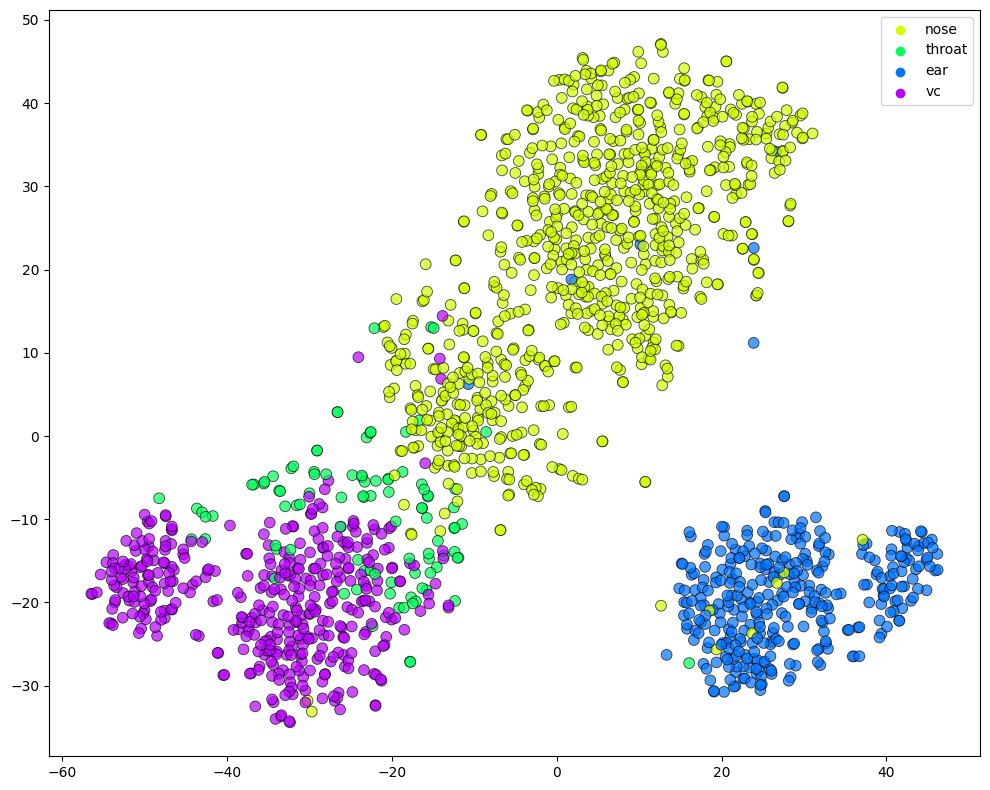

In [23]:
import pandas as pd
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
import seaborn as sns
import numpy as np

embeddings = []
labels = []

print("Computing BiomedCLIP embeddings for visualization...")
for _, row in tqdm(df_combined.iterrows(), total=len(df_combined)):
    try:
        emb = get_combined_embedding(row, include_text=True)
        embeddings.append(emb)
        labels.append(row["Coarse_Classification"])
    except Exception as e:
        print(f"Skipped {row['Path']} due to error: {e}")

embeddings = np.vstack(embeddings)
labels = np.array(labels)

# Dimensionality reduction
print("Reducing dimensionality with t-SNE...")
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
embeddings_2d = tsne.fit_transform(embeddings)

# Encode labels for coloring
le = LabelEncoder()
labels_encoded = le.fit_transform(labels)

# Plot
plt.figure(figsize=(10, 8))
palette = sns.color_palette("hsv", len(np.unique(labels)))
sns.scatterplot(x=embeddings_2d[:, 0], y=embeddings_2d[:, 1],
                hue=labels, palette=palette, s=60, alpha=0.7, edgecolor="k")
# plt.title("BiomedCLIP Embeddings (Train) Projected via t-SNE")
plt.legend(loc="best", bbox_to_anchor=(1, 1))
plt.tight_layout()
plt.show()

In [24]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from PIL import Image
from transformers import AutoImageProcessor, AutoModel

In [25]:
from torchvision import transforms as T

train_aug = T.Compose([
    T.Resize((224, 168)),
    T.RandomRotation(degrees=15),  # Small, simulates realistic probe angle variation
    T.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.05),  # Illumination noise
    T.GaussianBlur(kernel_size=3, sigma=(0.1, 1.0)),  # Simulate focus blur from endoscope
])

In [26]:
class EndoFineDataset(Dataset):
    def __init__(self, df, image_dir, processor, label_map=None, transform=None):
        self.df = df
        self.image_dir = image_dir
        self.processor = processor
        self.transform = transform
        self.label_map = label_map or {label: i for i, label in enumerate(sorted(df['Classification'].unique()))}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        label = self.label_map[row["Classification"]]
        img_path = os.path.join(self.image_dir, row["Path"])
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        processed = self.processor(images=image, return_tensors="pt")
        return {
            "pixel_values": processed["pixel_values"].squeeze(0),
            "label": torch.tensor(label, dtype=torch.long)
        }
        
class EndoDataset(Dataset):
    def __init__(self, df, image_dir, processor, label_map=None, transform=None):
        self.df = df
        self.image_dir = image_dir
        self.processor = processor
        self.transform = transform
        self.label_map = label_map or {label: i for i, label in enumerate(sorted(df['Coarse_Classification'].unique()))}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        label = self.label_map[row["Coarse_Classification"]]
        img_path = os.path.join(self.image_dir, row["Path"])
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        processed = self.processor(images=image, return_tensors="pt")
        return {
            "pixel_values": processed["pixel_values"].squeeze(0),
            "label": torch.tensor(label, dtype=torch.long)
        }
        
class NoseDataset(Dataset):
    def __init__(self, df, image_dir, processor, transform=None):
        self.df = df[df["Classification"].isin(["nose-left", "nose-right"])].reset_index(drop=True)
        self.image_dir = image_dir
        self.processor = processor
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        label = 0 if row["Classification"] == "nose-left" else 1
        img_path = os.path.join(self.image_dir, row["Path"])
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        processed = self.processor(images=image, return_tensors="pt")
        return {
            "pixel_values": processed["pixel_values"].squeeze(0),
            "label": torch.tensor(label, dtype=torch.float)
        }

class EarDataset(Dataset):
    def __init__(self, df, image_dir, processor, transform=None):
        self.df = df[df["Classification"].isin(["ear-left", "ear-right"])].reset_index(drop=True)
        self.image_dir = image_dir
        self.processor = processor
        self.transform = transform

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        label = 0 if row["Classification"] == "ear-left" else 1
        img_path = os.path.join(self.image_dir, row["Path"])
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        processed = self.processor(images=image, return_tensors="pt")
        return {
            "pixel_values": processed["pixel_values"].squeeze(0),
            "label": torch.tensor(label, dtype=torch.float)
        }

class VCDataset(Dataset):
    def __init__(self, df, image_dir, processor, transform=None):
        self.df = df[df["Classification"].isin(["vc-open", "vc-closed"])].reset_index(drop=True)
        self.image_dir = image_dir
        self.processor = processor
        self.transform = transform
        
    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        label = 0 if row["Classification"] == "vc-open" else 1
        img_path = os.path.join(self.image_dir, row["Path"])
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        processed = self.processor(images=image, return_tensors="pt")
        return {
            "pixel_values": processed["pixel_values"].squeeze(0),
            "label": torch.tensor(label, dtype=torch.float)
        }

In [27]:
import torch
import torch.nn as nn
from transformers import AutoModel

class DINOv2Classifier(nn.Module):
    def __init__(self, dinov2_name="facebook/dinov2-base", num_classes=1, dropout=0.3):
        super().__init__()
        self.dinov2 = AutoModel.from_pretrained(dinov2_name)
        dinov2_hidden_dim = self.dinov2.config.hidden_size

        self.classifier = nn.Sequential(
            nn.LayerNorm(dinov2_hidden_dim),
            nn.Dropout(dropout),
            nn.Linear(dinov2_hidden_dim, 256),
            nn.GELU(),
            nn.Dropout(dropout),
            nn.Linear(256, 128),
            nn.GELU(),
            nn.Dropout(dropout),
            nn.Linear(128, num_classes)
        )

    def forward(self, x_rgb):
        # DINOv2 expects 3-channel input
        dinov2_out = self.dinov2(pixel_values=x_rgb)
        dinov2_feat = dinov2_out.last_hidden_state.mean(dim=1)  # [B, dinov2_hidden_dim]
        return self.classifier(dinov2_feat)

In [28]:
from sklearn.metrics import accuracy_score
from tqdm import tqdm
import copy
import torch.nn.functional as F
from torch.amp import autocast, GradScaler  # <-- new import location in PyTorch 2.x
import matplotlib.pyplot as plt

def train_model(model, criterion, optimizer, train_loader, test_loader, epochs=10, num_classes=1):
    best_model = None
    best_acc = 0.0
    best_loss = float("inf")
    scaler = GradScaler()

    train_losses = []
    test_losses = []
    test_accuracies = []

    for epoch in range(epochs):
        model.train()
        running_loss = 0.0

        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs} - Training"):
            inputs = batch["pixel_values"].to(device)
            labels = batch["label"].to(device)

            optimizer.zero_grad()

            with autocast('cuda'):
                outputs = model(inputs)
                if num_classes == 1:
                    outputs = outputs.squeeze(-1)
                    loss = criterion(outputs, labels.float())
                else:
                    loss = criterion(outputs, labels.long())

            scaler.scale(loss).backward()
            scaler.step(optimizer)
            scaler.update()

            running_loss += loss.item() * inputs.size(0)

        avg_train_loss = running_loss / len(train_loader.dataset)
        train_losses.append(avg_train_loss)

        # Evaluation
        model.eval()
        all_preds, all_labels = [], []
        test_loss = 0.0
        with torch.no_grad():
            for batch in tqdm(test_loader, desc=f"Epoch {epoch+1}/{epochs} - Evaluating"):
                inputs = batch["pixel_values"].to(device)
                labels = batch["label"].to(device)
                outputs = model(inputs)

                if num_classes == 1:
                    outputs = outputs.squeeze(-1)
                    loss = criterion(outputs, labels.float())
                    probs = torch.sigmoid(outputs)
                    preds = (probs > 0.5).long()
                else:
                    loss = criterion(outputs, labels.long())
                    probs = F.softmax(outputs, dim=1)
                    preds = torch.argmax(probs, dim=1)

                test_loss += loss.item() * inputs.size(0)
                all_preds.extend(preds.cpu().numpy())
                all_labels.extend(labels.cpu().numpy())

        avg_test_loss = test_loss / len(test_loader.dataset)
        acc = accuracy_score(all_labels, all_preds)
        test_losses.append(avg_test_loss)
        test_accuracies.append(acc)

        print(f"Epoch {epoch+1}/{epochs} | Train Loss: {avg_train_loss:.4f} | Test Loss: {avg_test_loss:.4f} | Test Acc: {acc:.4f}")

        if (acc > best_acc) or (acc == best_acc and avg_test_loss < best_loss):
            best_acc = acc
            best_loss = avg_test_loss
            best_model = copy.deepcopy(model)
            print("✅ Saved best model")

    # Plot training and validation metrics
    epochs_range = range(1, epochs + 1)
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(epochs_range, train_losses, label='Train Loss')
    plt.plot(epochs_range, test_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Train vs Validation Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(epochs_range, test_accuracies, label='Validation Accuracy', color='green')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.title('Validation Accuracy')
    plt.legend()

    plt.tight_layout()
    plt.show()

    return best_model

In [29]:
import gc

gc.collect()
torch.cuda.empty_cache()

In [30]:
# Hyperparameters
BATCH_SIZE = 64
LR = 1e-5
WD = 1e-2
EPOCHS = 20
SEED = 42
torch.manual_seed(SEED)

In [31]:
SURGENET_DINO = "/kaggle/input/surgenet-public-dino/pytorch/default/2/Public_checkpoint0050.pth"

In [32]:
processor = AutoImageProcessor.from_pretrained("facebook/dinov2-base")
train_dataset = EndoFineDataset(df_train, DATA_PATH, processor, transform=train_aug)
val_dataset = EndoFineDataset(df_val, DATA_PATH, processor)
test_dataset = EndoFineDataset(df_test, DATA_PATH, processor)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

baseline_model = DINOv2Classifier(num_classes=7).to(device)
dinov2_state_dict = torch.load(SURGENET_DINO, map_location=device, weights_only=False)
baseline_model.dinov2.load_state_dict(dinov2_state_dict, strict=False)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(baseline_model.parameters(), lr=LR, weight_decay=WD)

preprocessor_config.json:   0%|          | 0.00/436 [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


config.json:   0%|          | 0.00/548 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Epoch 1/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.41s/it]


Epoch 1/20 | Train Loss: 1.6999 | Test Loss: 1.5240 | Test Acc: 0.4194
✅ Saved best model


Epoch 2/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.40s/it]


Epoch 2/20 | Train Loss: 1.3193 | Test Loss: 1.1441 | Test Acc: 0.6290
✅ Saved best model


Epoch 3/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.48s/it]


Epoch 3/20 | Train Loss: 1.0818 | Test Loss: 0.9135 | Test Acc: 0.7903
✅ Saved best model


Epoch 4/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.56s/it]


Epoch 4/20 | Train Loss: 0.8659 | Test Loss: 0.8522 | Test Acc: 0.8011
✅ Saved best model


Epoch 5/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.45s/it]


Epoch 5/20 | Train Loss: 0.6808 | Test Loss: 0.6631 | Test Acc: 0.8065
✅ Saved best model


Epoch 6/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 6/20 | Train Loss: 0.5586 | Test Loss: 0.5067 | Test Acc: 0.9086
✅ Saved best model


Epoch 7/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.39s/it]


Epoch 7/20 | Train Loss: 0.4211 | Test Loss: 0.5799 | Test Acc: 0.8280


Epoch 8/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.39s/it]


Epoch 8/20 | Train Loss: 0.3630 | Test Loss: 0.4347 | Test Acc: 0.8925


Epoch 9/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 9/20 | Train Loss: 0.3137 | Test Loss: 0.5206 | Test Acc: 0.8602


Epoch 10/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 10/20 | Train Loss: 0.3232 | Test Loss: 0.3924 | Test Acc: 0.9140
✅ Saved best model


Epoch 11/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.37s/it]


Epoch 11/20 | Train Loss: 0.2694 | Test Loss: 0.4024 | Test Acc: 0.8925


Epoch 12/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 12/20 | Train Loss: 0.2326 | Test Loss: 0.4145 | Test Acc: 0.8925


Epoch 13/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.41s/it]


Epoch 13/20 | Train Loss: 0.1996 | Test Loss: 0.3462 | Test Acc: 0.9086


Epoch 14/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.44s/it]


Epoch 14/20 | Train Loss: 0.1990 | Test Loss: 0.3488 | Test Acc: 0.9355
✅ Saved best model


Epoch 15/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 15/20 | Train Loss: 0.1863 | Test Loss: 0.5602 | Test Acc: 0.8387


Epoch 16/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.36s/it]


Epoch 16/20 | Train Loss: 0.1716 | Test Loss: 0.3531 | Test Acc: 0.9247


Epoch 17/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.35s/it]


Epoch 17/20 | Train Loss: 0.1664 | Test Loss: 0.3690 | Test Acc: 0.8978


Epoch 18/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.48s/it]


Epoch 18/20 | Train Loss: 0.1914 | Test Loss: 0.4397 | Test Acc: 0.8763


Epoch 19/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 19/20 | Train Loss: 0.1573 | Test Loss: 0.2798 | Test Acc: 0.9301


Epoch 20/20 - Evaluating: 100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


Epoch 20/20 | Train Loss: 0.1309 | Test Loss: 0.2755 | Test Acc: 0.9247


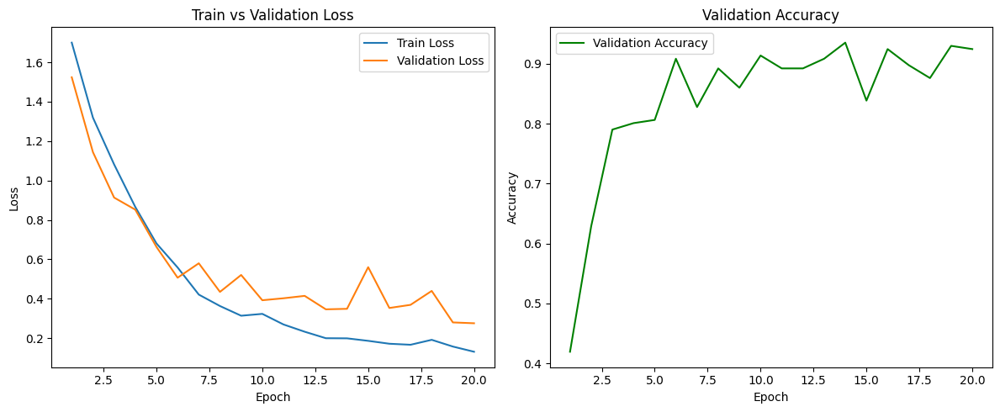

In [33]:
baseline_model = train_model(baseline_model, criterion, optimizer, train_loader, val_loader, EPOCHS, num_classes=7)

              precision    recall  f1-score   support

    ear-left     0.8500    0.9444    0.8947        18
   ear-right     0.9474    0.9000    0.9231        20
   nose-left     0.9524    0.8511    0.8989        47
  nose-right     0.8800    0.9565    0.9167        46
      throat     1.0000    0.8000    0.8889        10
   vc-closed     0.9048    0.9048    0.9048        21
     vc-open     0.9231    1.0000    0.9600        24

    accuracy                         0.9140       186
   macro avg     0.9225    0.9081    0.9124       186
weighted avg     0.9174    0.9140    0.9135       186



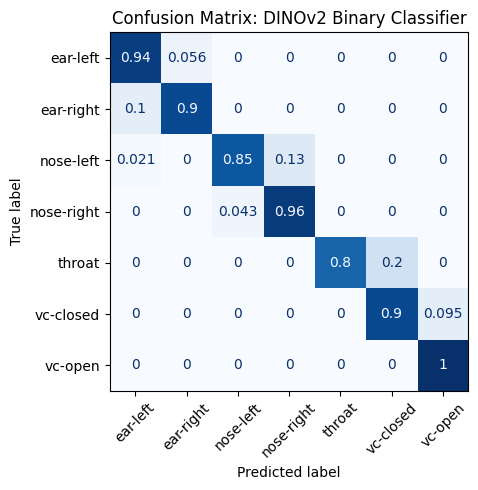

In [34]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import torch.nn.functional as F

# Collect predictions, true labels, confidences
all_preds, all_labels, all_confs = [], [], []
# high_conf_correct = 0
# high_conf_total = 0
# confidence_threshold = 0.7

baseline_model.eval()
with torch.no_grad():
    for batch in test_loader:
        inputs = batch["pixel_values"].to(device)
        labels = batch["label"].long().to(device)  # Convert to long for classification

        outputs = baseline_model(inputs)  # shape: [B, num_classes]
        probs = F.softmax(outputs, dim=1)  # [B, num_classes]
        confs, preds = torch.max(probs, dim=1)  # Get max confidence and predicted class

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_confs.extend(confs.cpu().numpy())

        # # Count high-confidence correct predictions
        # high_conf_mask = confs > confidence_threshold
        # correct_mask = preds == labels
        # high_conf_correct += torch.sum(high_conf_mask & correct_mask).item()
        # high_conf_total += torch.sum(high_conf_mask).item()

# # Compute ratio
# if high_conf_total > 0:
#     high_conf_ratio = high_conf_correct / high_conf_total
# else:
#     high_conf_ratio = 0.0

# print(f"Total high-confidence predictions (> {confidence_threshold}): {high_conf_total}")
# print(f"Correct high-confidence predictions: {high_conf_correct}")
# print(f"Ratio: {high_conf_ratio:.4f}")

# Classification report
target_names = sorted(["nose-left", "nose-right", "throat", "ear-left", "ear-right", "vc-open", "vc-closed"])
print(classification_report(all_labels, all_preds, target_names=target_names, digits=4))

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds, labels=[0, 1, 2, 3, 4, 5, 6], normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)

# Plot
fig, ax = plt.subplots(figsize=(6, 5))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
plt.title("Confusion Matrix: DINOv2 Binary Classifier")
plt.tight_layout()
plt.show()

100%|██████████| 3/3 [00:04<00:00,  1.39s/it]


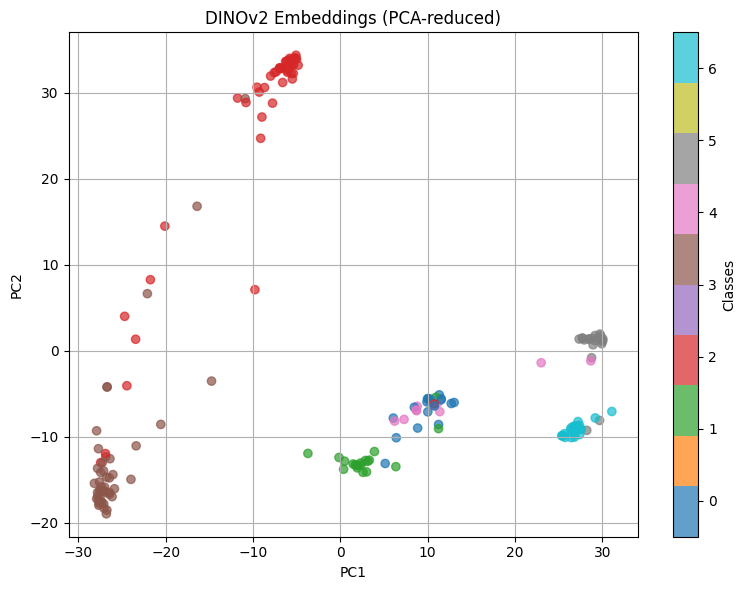

In [35]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import numpy as np

# Step 1: Collect embeddings and labels
embeddings, labels = [], []

baseline_model.eval()
with torch.no_grad():
    for batch in tqdm(test_loader):
        inputs = batch["pixel_values"].to(device)
        batch_labels = batch["label"].long().to(device)

        dinov2_out = baseline_model.dinov2(pixel_values=inputs)
        dinov2_feat = dinov2_out.last_hidden_state.mean(dim=1)  # [B, D]

        embeddings.append(dinov2_feat.cpu())
        labels.append(batch_labels.cpu())

embeddings = torch.cat(embeddings, dim=0).numpy()  # [N, D]
labels = torch.cat(labels, dim=0).numpy()          # [N]

# Step 2: Dimensionality reduction (use PCA or t-SNE)
# Faster: PCA
pca = PCA(n_components=2)
emb_2d = pca.fit_transform(embeddings)

# Alternatively: t-SNE (more expressive but slower)
# tsne = TSNE(n_components=2, perplexity=30, random_state=42)
# emb_2d = tsne.fit_transform(embeddings)

# Step 3: Plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(emb_2d[:, 0], emb_2d[:, 1], c=labels, cmap="tab10", alpha=0.7)
plt.title("DINOv2 Embeddings (PCA-reduced)")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.colorbar(scatter, ticks=range(len(target_names)), label="Classes")
plt.clim(-0.5, len(target_names) - 0.5)
plt.grid(True)
plt.tight_layout()
plt.show()

In [36]:
processor = AutoImageProcessor.from_pretrained("facebook/dinov2-base")
train_dataset = EndoDataset(df_train, DATA_PATH, processor, transform=train_aug)
val_dataset = EndoDataset(df_val, DATA_PATH, processor)
test_dataset = EndoDataset(df_test, DATA_PATH, processor)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

full_model = DINOv2Classifier(num_classes=4).to(device)
dinov2_state_dict = torch.load(SURGENET_DINO, map_location=device, weights_only=False)
full_model.dinov2.load_state_dict(dinov2_state_dict, strict=False)
criterion = nn.CrossEntropyLoss()
optimizer = optim.AdamW(full_model.parameters(), lr=LR, weight_decay=WD)

In [37]:
# full_model = train_model(full_model, criterion, optimizer, train_loader, val_loader, EPOCHS, num_classes=4)
full_model = torch.load(os.path.join(ROOT_PATH, "entrep-prototypical/full_model.pt"), weights_only=False)

              precision    recall  f1-score   support

         ear       0.97      1.00      0.99        38
        nose       1.00      0.99      0.99        93
      throat       1.00      1.00      1.00        10
          vc       1.00      1.00      1.00        45

    accuracy                           0.99       186
   macro avg       0.99      1.00      1.00       186
weighted avg       0.99      0.99      0.99       186



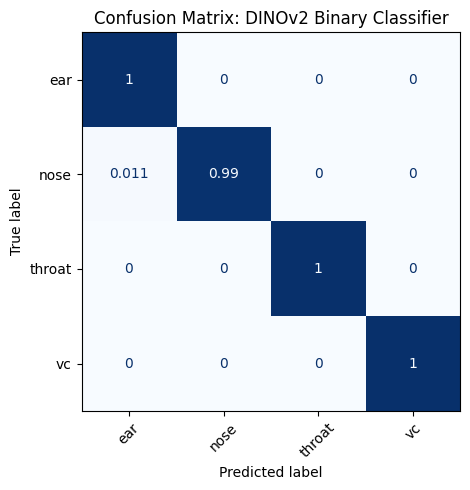

In [38]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import torch.nn.functional as F

# Collect predictions, true labels, confidences
all_preds, all_labels, all_confs = [], [], []
# high_conf_correct = 0
# high_conf_total = 0
# confidence_threshold = 0.7

model.eval()
with torch.no_grad():
    for batch in test_loader:
        inputs = batch["pixel_values"].to(device)
        labels = batch["label"].long().to(device)  # Convert to long for classification

        outputs = full_model(inputs)  # shape: [B, num_classes]
        probs = F.softmax(outputs, dim=1)  # [B, num_classes]
        confs, preds = torch.max(probs, dim=1)  # Get max confidence and predicted class

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())
        all_confs.extend(confs.cpu().numpy())

        # # Count high-confidence correct predictions
        # high_conf_mask = confs > confidence_threshold
        # correct_mask = preds == labels
        # high_conf_correct += torch.sum(high_conf_mask & correct_mask).item()
        # high_conf_total += torch.sum(high_conf_mask).item()

# # Compute ratio
# if high_conf_total > 0:
#     high_conf_ratio = high_conf_correct / high_conf_total
# else:
#     high_conf_ratio = 0.0

# print(f"Total high-confidence predictions (> {confidence_threshold}): {high_conf_total}")
# print(f"Correct high-confidence predictions: {high_conf_correct}")
# print(f"Ratio: {high_conf_ratio:.4f}")

# Classification report
target_names = sorted(["nose", "throat", "ear", "vc"])
print(classification_report(all_labels, all_preds, target_names=target_names))

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds, labels=[0, 1, 2, 3], normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)

# Plot
fig, ax = plt.subplots(figsize=(6, 5))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
plt.title("Confusion Matrix: DINOv2 Binary Classifier")
plt.tight_layout()
plt.show()

100%|██████████| 3/3 [00:04<00:00,  1.38s/it]


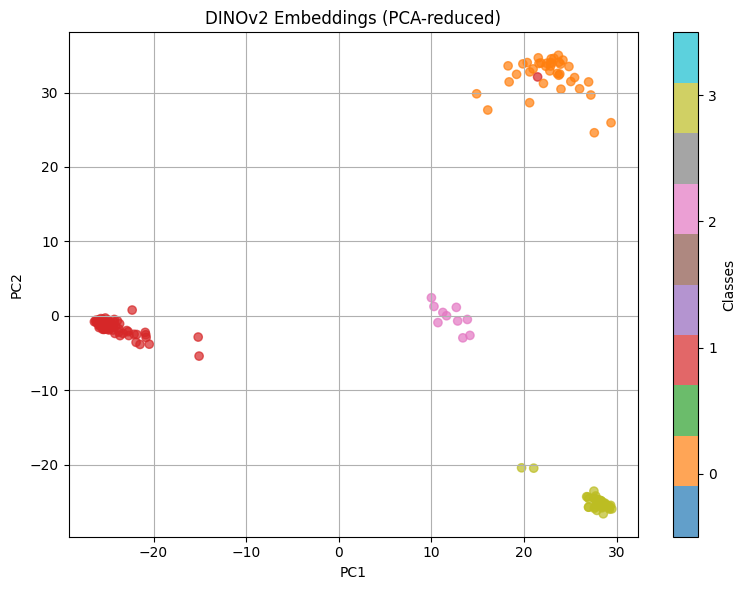

In [39]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import numpy as np

# Step 1: Collect embeddings and labels
embeddings, labels = [], []

full_model.eval()
with torch.no_grad():
    for batch in tqdm(test_loader):
        inputs = batch["pixel_values"].to(device)
        batch_labels = batch["label"].long().to(device)

        dinov2_out = full_model.dinov2(pixel_values=inputs)
        dinov2_feat = dinov2_out.last_hidden_state.mean(dim=1)  # [B, D]

        embeddings.append(dinov2_feat.cpu())
        labels.append(batch_labels.cpu())

embeddings = torch.cat(embeddings, dim=0).numpy()  # [N, D]
labels = torch.cat(labels, dim=0).numpy()          # [N]

# Step 2: Dimensionality reduction (use PCA or t-SNE)
# Faster: PCA
pca = PCA(n_components=2)
emb_2d = pca.fit_transform(embeddings)

# Alternatively: t-SNE (more expressive but slower)
# tsne = TSNE(n_components=2, perplexity=30, random_state=42)
# emb_2d = tsne.fit_transform(embeddings)

# Step 3: Plot
plt.figure(figsize=(8, 6))
scatter = plt.scatter(emb_2d[:, 0], emb_2d[:, 1], c=labels, cmap="tab10", alpha=0.7)
plt.title("DINOv2 Embeddings (PCA-reduced)")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.colorbar(scatter, ticks=range(len(target_names)), label="Classes")
plt.clim(-0.5, len(target_names) - 0.5)
plt.grid(True)
plt.tight_layout()
plt.show()

In [40]:
import gc

gc.collect()
torch.cuda.empty_cache()

In [41]:
processor = AutoImageProcessor.from_pretrained("facebook/dinov2-base")
train_dataset = NoseDataset(df_train, DATA_PATH, processor, transform=train_aug)
val_dataset = NoseDataset(df_val, DATA_PATH, processor)
test_dataset = NoseDataset(df_test, DATA_PATH, processor)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

nose_model = DINOv2Classifier().to(device)
dinov2_state_dict = torch.load(SURGENET_DINO, map_location=device, weights_only=False)
nose_model.dinov2.load_state_dict(dinov2_state_dict, strict=False)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.AdamW(nose_model.parameters(), lr=LR, weight_decay=WD)

In [42]:
# nose_model = train_model(nose_model, criterion, optimizer, train_loader, val_loader, EPOCHS)
nose_model = torch.load(os.path.join(ROOT_PATH, "entrep-prototypical/nose_model.pt"), weights_only=False)

              precision    recall  f1-score   support

   nose-left     0.9362    0.9362    0.9362        47
  nose-right     0.9348    0.9348    0.9348        46

    accuracy                         0.9355        93
   macro avg     0.9355    0.9355    0.9355        93
weighted avg     0.9355    0.9355    0.9355        93



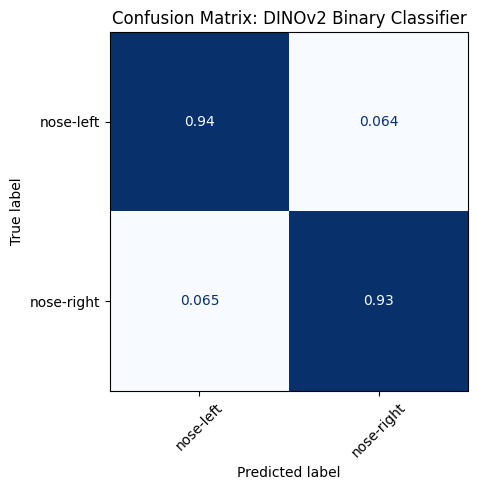

In [43]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Collect predictions and true labels
all_preds, all_labels = [], []
target_names = ["nose-left", "nose-right"]

model.eval()
with torch.no_grad():
    for batch in test_loader:
        inputs = batch["pixel_values"].to(device)
        labels = batch["label"].float().to(device)     # Ensure float for BCE loss
        outputs = nose_model(inputs).squeeze(1)             # [B, 1] → [B]
        probs = torch.sigmoid(outputs)                 # sigmoid for binary classification
        preds = (probs > 0.5).long()

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy().astype(int))

# Classification report
print(classification_report(all_labels, all_preds, target_names=target_names, digits=4))

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds, labels=[0, 1], normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)

# Plot
fig, ax = plt.subplots(figsize=(6, 5))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
plt.title("Confusion Matrix: DINOv2 Binary Classifier")
plt.tight_layout()
plt.show()

In [44]:
import gc

gc.collect()
torch.cuda.empty_cache()

In [45]:
processor = AutoImageProcessor.from_pretrained("facebook/dinov2-base")
train_dataset = EarDataset(df_train, DATA_PATH, processor, transform=train_aug)
val_dataset = EarDataset(df_val, DATA_PATH, processor)
test_dataset = EarDataset(df_test, DATA_PATH, processor)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

ear_model = DINOv2Classifier().to(device)
dinov2_state_dict = torch.load(SURGENET_DINO, map_location=device, weights_only=False)
ear_model.dinov2.load_state_dict(dinov2_state_dict, strict=False)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.AdamW(ear_model.parameters(), lr=LR, weight_decay=WD)

In [46]:
# ear_model = train_model(ear_model, criterion, optimizer, train_loader, val_loader, EPOCHS)
ear_model = torch.load(os.path.join(ROOT_PATH, "entrep-prototypical/ear_model.pt"), weights_only=False)

              precision    recall  f1-score   support

    ear-left     0.8947    0.9444    0.9189        18
   ear-right     0.9474    0.9000    0.9231        20

    accuracy                         0.9211        38
   macro avg     0.9211    0.9222    0.9210        38
weighted avg     0.9224    0.9211    0.9211        38



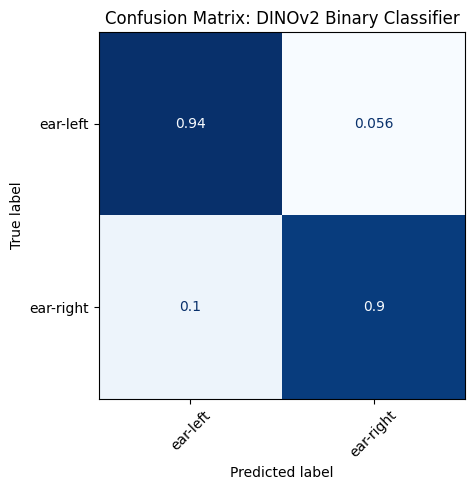

In [47]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Collect predictions and true labels
all_preds, all_labels = [], []
target_names = ["ear-left", "ear-right"]

model.eval()
with torch.no_grad():
    for batch in test_loader:
        inputs = batch["pixel_values"].to(device)
        labels = batch["label"].float().to(device)     # Ensure float for BCE loss
        outputs = ear_model(inputs).squeeze(1)             # [B, 1] → [B]
        probs = torch.sigmoid(outputs)                 # sigmoid for binary classification
        preds = (probs > 0.5).long()

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy().astype(int))

# Classification report
print(classification_report(all_labels, all_preds, target_names=target_names, digits=4))

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds, labels=[0, 1], normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)

# Plot
fig, ax = plt.subplots(figsize=(6, 5))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
plt.title("Confusion Matrix: DINOv2 Binary Classifier")
plt.tight_layout()
plt.show()

In [48]:
import gc

gc.collect()
torch.cuda.empty_cache()

In [49]:
processor = AutoImageProcessor.from_pretrained("facebook/dinov2-base")
train_dataset = VCDataset(df_train, DATA_PATH, processor, transform=train_aug)
val_dataset = VCDataset(df_val, DATA_PATH, processor)
test_dataset = VCDataset(df_test, DATA_PATH, processor)

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE)

vc_model = DINOv2Classifier().to(device)
dinov2_state_dict = torch.load(SURGENET_DINO, map_location=device, weights_only=False)
vc_model.dinov2.load_state_dict(dinov2_state_dict, strict=False)
criterion = nn.BCEWithLogitsLoss()
optimizer = optim.AdamW(vc_model.parameters(), lr=LR, weight_decay=WD)

In [50]:
# vc_model = train_model(vc_model, criterion, optimizer, train_loader, val_loader, EPOCHS)
vc_model = torch.load(os.path.join(ROOT_PATH, "entrep-prototypical/vc_model.pt"), weights_only=False)

              precision    recall  f1-score   support

     vc-open     0.9583    0.9583    0.9583        24
   vc-closed     0.9524    0.9524    0.9524        21

    accuracy                         0.9556        45
   macro avg     0.9554    0.9554    0.9554        45
weighted avg     0.9556    0.9556    0.9556        45



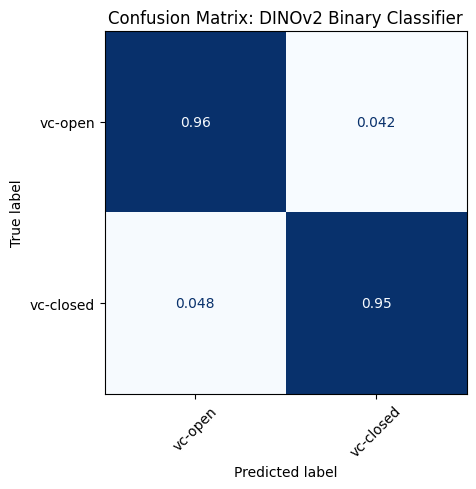

In [51]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Collect predictions and true labels
all_preds, all_labels = [], []
target_names = ["vc-open", "vc-closed"]

model.eval()
with torch.no_grad():
    for batch in test_loader:
        inputs = batch["pixel_values"].to(device)
        labels = batch["label"].float().to(device)     # Ensure float for BCE loss
        outputs = vc_model(inputs).squeeze(1)             # [B, 1] → [B]
        probs = torch.sigmoid(outputs)                 # sigmoid for binary classification
        preds = (probs > 0.5).long()

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy().astype(int))

# Classification report
print(classification_report(all_labels, all_preds, target_names=target_names, digits=4))

# Confusion matrix
cm = confusion_matrix(all_labels, all_preds, labels=[0, 1], normalize="true")
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=target_names)

# Plot
fig, ax = plt.subplots(figsize=(6, 5))
disp.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
plt.title("Confusion Matrix: DINOv2 Binary Classifier")
plt.tight_layout()
plt.show()

In [52]:
import gc

gc.collect()
torch.cuda.empty_cache()

In [53]:
# Save models to .pt files
torch.save(full_model, "full_model.pt")
torch.save(ear_model, "ear_model.pt")
torch.save(nose_model, "nose_model.pt")
torch.save(vc_model, "vc_model.pt")
torch.save(baseline_model, "baseline_model.pt")

In [54]:
import os
import torch
import numpy as np
import faiss
import pandas as pd
from PIL import Image
from tqdm import tqdm
import open_clip
from sklearn.metrics import accuracy_score, classification_report
from collections import defaultdict

class BiomedCLIPClassifier(torch.nn.Module):
    def __init__(self, image_dir, prototype_index_path, prototype_class_names, 
                 train_index_path=None, train_df=None,
                 binary_models=None, use_text=False):
        super().__init__()
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        clip_model_name = "hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224"
        self.model, _, self.preprocess = open_clip.create_model_and_transforms(clip_model_name)
        self.tokenizer = open_clip.get_tokenizer(clip_model_name)
        self.model = self.model.to(self.device).eval()
        self.image_dir = image_dir
        self.use_text = use_text

        self.binary_models = binary_models or {}
        for name, model in self.binary_models.items():
            self.binary_models[name] = model.to(self.device).eval()

        self.prototype_classes = prototype_class_names
        self.index = faiss.read_index(prototype_index_path)

        if train_index_path and train_df is not None:
            self.train_index = faiss.read_index(train_index_path)
            self.train_df = train_df
        else:
            self.train_index = None
            self.train_df = None

    def embed_image_text(self, row):
        img_path = os.path.join(self.image_dir, row["Path"])
        img = self.preprocess(Image.open(img_path).convert("RGB")).unsqueeze(0).to(self.device)

        if self.use_text:
            text = row["DescriptionEN"] if isinstance(row["DescriptionEN"], str) else ""
            text_tokens = self.tokenizer([text]).to(self.device)
            with torch.no_grad(), torch.amp.autocast("cuda"):
                img_emb = self.model.encode_image(img)
                txt_emb = self.model.encode_text(text_tokens)
            sim = torch.nn.functional.cosine_similarity(img_emb, txt_emb, dim=1)
            combined_emb = img_emb * sim.unsqueeze(1) + txt_emb * (1 - sim.unsqueeze(1))
            return combined_emb.squeeze(0).cpu().numpy(), img
        else:
            with torch.no_grad(), torch.cuda.amp.autocast():
                img_emb = self.model.encode_image(img)
            return img_emb.squeeze(0).cpu().numpy(), img

    def classify(self, row, threshold=0.99):
        emb, img_tensor = self.embed_image_text(row)
        emb = emb.astype("float32").reshape(1, -1)
        faiss.normalize_L2(emb)
        D, I = self.index.search(emb, 1)
        pred_proto = self.prototype_classes[I[0][0]]
        proto_confidence = D[0][0]  # Cosine similarity because embeddings are L2-normalized
    
        if proto_confidence >= threshold:
            pred_coarse = pred_proto
        else:
            pred_coarse = pred_proto  # default
            if "full" in self.binary_models:
                with torch.no_grad():
                    logits = self.binary_models["full"](img_tensor)  # shape: [1, num_coarse_classes]
                    probs = torch.softmax(logits, dim=1)
                    max_prob, max_idx = torch.max(probs, dim=1)
                    pred_coarse = self.prototype_classes[max_idx.item()]  # reassign based on full_model
    
        pred_fine = pred_coarse
        if pred_coarse in self.binary_models:
            with torch.no_grad():
                binary_out = self.binary_models[pred_coarse](img_tensor).sigmoid()
                binary_pred = int(binary_out.item() > 0.5)
                pred_fine = self.fine_class_label(pred_coarse, binary_pred)
    
        return pred_coarse, pred_fine
        
    @staticmethod
    def fine_class_label(coarse, binary_label):
        label_map = {
            "ear": ["ear-left", "ear-right"],
            "nose": ["nose-left", "nose-right"],
            "vc": ["vc-open", "vc-closed"],
            "throat": ["throat", "throat"]
        }
        return label_map.get(coarse, [coarse])[binary_label]

    def evaluate(self, df):
        y_true, y_pred = [], []
        y_fine_true, y_fine_pred = [], []

        for _, row in tqdm(df.iterrows(), total=len(df)):
            coarse_pred, fine_pred = self.classify(row)
            y_true.append(row["Coarse_Classification"])
            y_pred.append(coarse_pred)
            y_fine_true.append(row["Classification"])
            y_fine_pred.append(fine_pred)

        print("\n📊 Coarse Classification Accuracy:")
        print(f"Accuracy: {accuracy_score(y_true, y_pred):.4f}")
        print(classification_report(y_true, y_pred, digits=4))

        print("\n📊 Fine (Binary) Classification Accuracy:")
        print(f"Accuracy: {accuracy_score(y_fine_true, y_fine_pred):.4f}")
        print(classification_report(y_fine_true, y_fine_pred, digits=4))

        # Coarse confusion matrix
        coarse_labels = ["ear", "nose", "throat", "vc"]
        cm_coarse = confusion_matrix(y_true, y_pred, labels=coarse_labels, normalize="true")
        disp_coarse = ConfusionMatrixDisplay(confusion_matrix=cm_coarse, display_labels=coarse_labels)
        fig, ax = plt.subplots(figsize=(10, 8))
        disp_coarse.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
        plt.title("Confusion Matrix: Coarse Classification (FAISS Prototype)")
        plt.tight_layout()
        plt.show()

        # Fine confusion matrix
        fine_labels = ["ear-left", "ear-right", "nose-left", "nose-right", "throat", "vc-closed", "vc-open"]
        cm_fine = confusion_matrix(y_fine_true, y_fine_pred, labels=fine_labels, normalize="true")
        disp_fine = ConfusionMatrixDisplay(confusion_matrix=cm_fine, display_labels=fine_labels)
        fig, ax = plt.subplots(figsize=(12, 10))
        disp_fine.plot(ax=ax, xticks_rotation=45, cmap="Blues", colorbar=False)
        plt.title("Confusion Matrix: Fine Classification (Binary Model Refinement)")
        plt.tight_layout()
        plt.show()
        
    def image_to_image_train_search(self, query_row, top_k=20):
        """
        Perform image-to-image search in training set, restricted to same fine class.
        """
        if self.train_index is None or self.train_df is None:
            raise ValueError("Training index or train_df not provided.")

        query_emb, _ = self.embed_image_text(query_row)
        query_emb = query_emb.astype("float32").reshape(1, -1)
        faiss.normalize_L2(query_emb)

        D, I = self.train_index.search(query_emb, top_k + 1)

        _, pred_fine = self.classify(query_row)
        candidates = self.train_df.iloc[I[0]].copy()
        candidates["Distance"] = D[0]

        fine_preds = []
        for _, row in candidates.iterrows():
            _, fine = self.classify(row)
            fine_preds.append(fine)
        candidates["Predicted_Fine"] = fine_preds

        candidates = candidates[candidates["Predicted_Fine"] == pred_fine]
        candidates = candidates[candidates["Path"] != query_row["Path"]]
        return candidates.sort_values("Distance").reset_index(drop=True)

    def text_to_image_train_search(self, query_text, top_k=20):
        """
        Perform text-to-image search over the training set.
        """
        if self.train_index is None or self.train_df is None:
            raise ValueError("Training index or train_df not provided.")
        
        text_tokens = self.tokenizer([query_text]).to(self.device)
        with torch.no_grad(), torch.cuda.amp.autocast():
            text_emb = self.model.encode_text(text_tokens).squeeze(0).cpu().numpy()
        
        text_emb = text_emb.astype("float32").reshape(1, -1)
        faiss.normalize_L2(text_emb)
        _, I = self.index.search(text_emb, 1)
        pred_coarse = self.prototype_classes[I[0][0]]
    
        D, I = self.train_index.search(text_emb, top_k + 1)
        candidates = self.train_df.iloc[I[0]].copy()
        candidates["Distance"] = D[0]

        coarse_preds = []
        for _, row in candidates.iterrows():
            coarse, _ = self.classify(row)
            coarse_preds.append(coarse)
        candidates["Predicted_Coarse"] = coarse_preds

        candidates = candidates[candidates["Predicted_Coarse"] == pred_coarse]
        return candidates.sort_values("Distance").reset_index(drop=True)

🔍 Generating prototypes...


  0%|          | 0/1671 [00:00<?, ?it/s]/tmp/ipykernel_19/2513407833.py:13: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.no_grad(), torch.cuda.amp.autocast():
100%|██████████| 1671/1671 [01:00<00:00, 27.57it/s]


🔍 Embedding training images for FAISS index...
🔧 Building FAISS index for training images...


100%|██████████| 186/186 [00:12<00:00, 14.67it/s]



📊 Coarse Classification Accuracy:
Accuracy: 0.9946
              precision    recall  f1-score   support

         ear     0.9744    1.0000    0.9870        38
        nose     1.0000    0.9892    0.9946        93
      throat     1.0000    1.0000    1.0000        10
          vc     1.0000    1.0000    1.0000        45

    accuracy                         0.9946       186
   macro avg     0.9936    0.9973    0.9954       186
weighted avg     0.9948    0.9946    0.9946       186


📊 Fine (Binary) Classification Accuracy:
Accuracy: 0.9409
              precision    recall  f1-score   support

    ear-left     0.8500    0.9444    0.8947        18
   ear-right     0.9474    0.9000    0.9231        20
   nose-left     0.9556    0.9149    0.9348        47
  nose-right     0.9362    0.9565    0.9462        46
      throat     1.0000    1.0000    1.0000        10
   vc-closed     0.9524    0.9524    0.9524        21
     vc-open     0.9583    0.9583    0.9583        24

    accuracy        

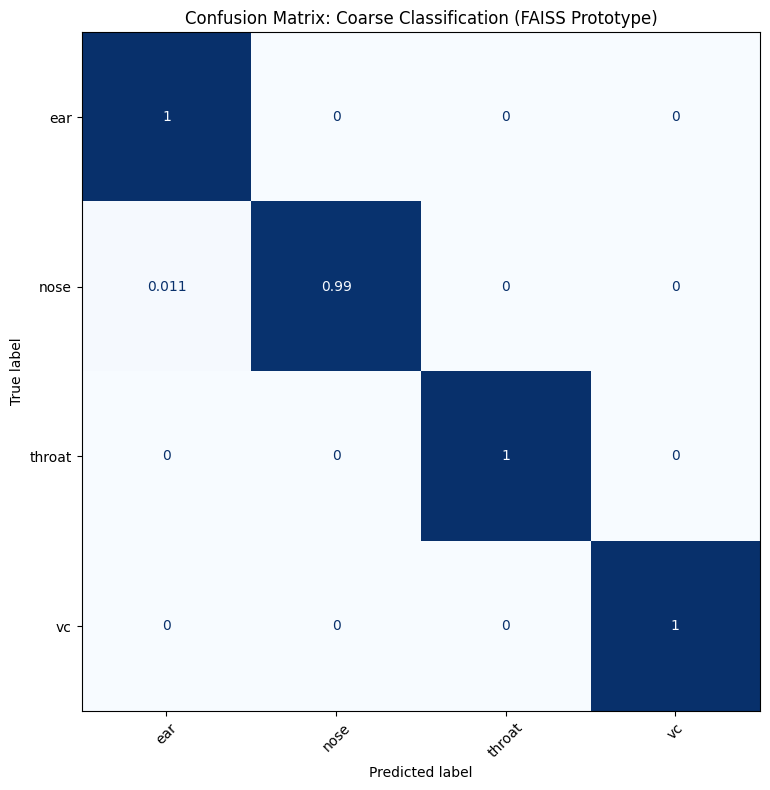

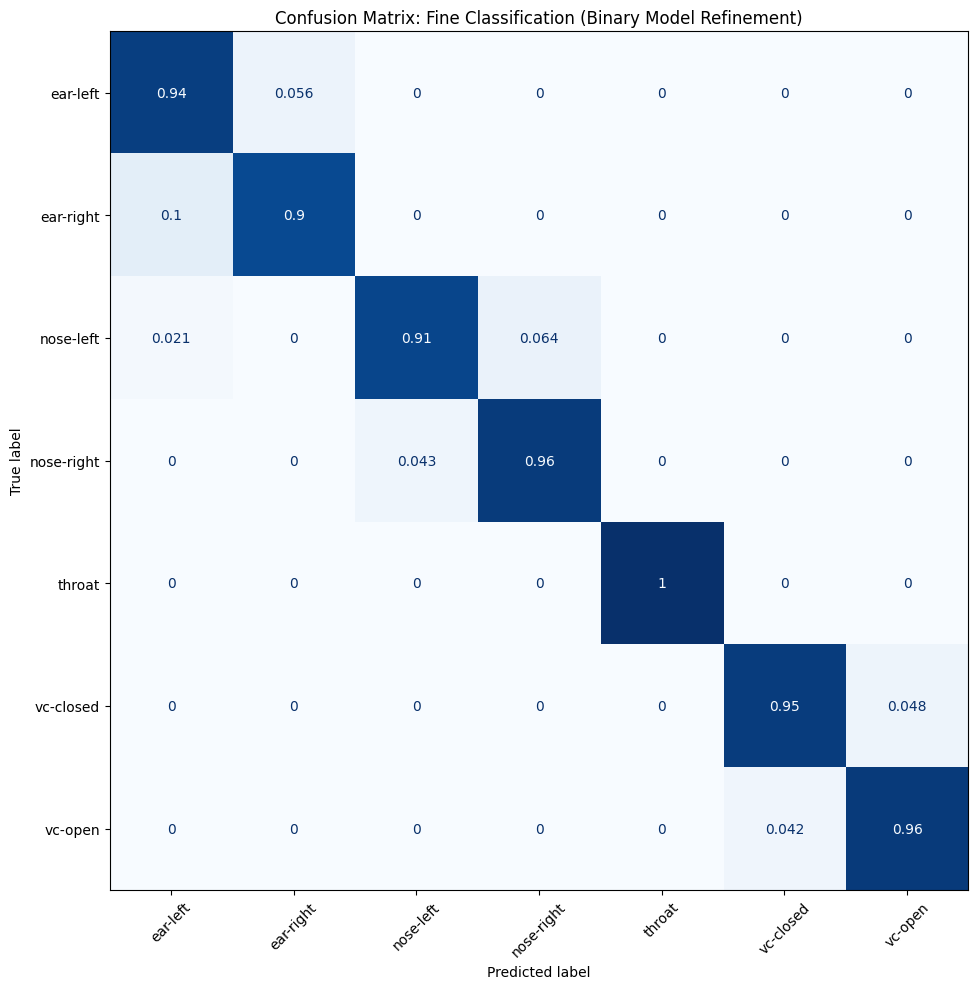

In [55]:
# Train-time prototype generation
print("🔍 Generating prototypes...")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model, _, preprocess = open_clip.create_model_and_transforms("hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224")
tokenizer = open_clip.get_tokenizer("hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224")
model = model.to(device).eval()

def embed_train(row):
    path = os.path.join(DATA_PATH, row["Path"])
    img = preprocess(Image.open(path).convert("RGB")).unsqueeze(0).to(device)
    text = row["DescriptionEN"] if isinstance(row["DescriptionEN"], str) else ""
    text_tokens = tokenizer([text]).to(device)
    with torch.no_grad(), torch.cuda.amp.autocast():
        img_emb = model.encode_image(img)
        txt_emb = model.encode_text(text_tokens)
    sim = torch.nn.functional.cosine_similarity(img_emb, txt_emb, dim=1)
    combined = img_emb * sim.unsqueeze(1) + txt_emb * (1 - sim.unsqueeze(1))
    return combined.squeeze(0).cpu().numpy()

df_combined = pd.concat([df_train, df_val], ignore_index=True)

protos = defaultdict(list)
for _, row in tqdm(df_combined.iterrows(), total=len(df_combined)):
    protos[row["Coarse_Classification"]].append(embed_train(row))

class_names = sorted(protos)
proto_mat = np.vstack([np.mean(protos[c], axis=0) for c in class_names]).astype('float32')
faiss.normalize_L2(proto_mat)
index = faiss.IndexFlatIP(proto_mat.shape[1])
index.add(proto_mat)
faiss.write_index(index, "prototypes.index")

# Compute and store all image embeddings in df_train
print("🔍 Embedding training images for FAISS index...")

df_combined["ImageEmbedding"] = df_combined.apply(embed_train, axis=1)

# Build FAISS index from training image embeddings
print("🔧 Building FAISS index for training images...")

train_embeddings = np.vstack(df_combined["ImageEmbedding"].values).astype("float32")
faiss.normalize_L2(train_embeddings)

train_index = faiss.IndexFlatIP(train_embeddings.shape[1])
train_index.add(train_embeddings)
faiss.write_index(train_index, "train_images.index")

# Load binary classifiers
binary_models = {
    "full": torch.load("full_model.pt", map_location=device, weights_only=False),
    "ear": torch.load("ear_model.pt", map_location=device, weights_only=False),
    "nose": torch.load("nose_model.pt", map_location=device, weights_only=False),
    "vc": torch.load("vc_model.pt", map_location=device, weights_only=False)
}

clf = BiomedCLIPClassifier(
    image_dir=DATA_PATH,
    prototype_index_path="prototypes.index",
    prototype_class_names=class_names,
    binary_models=binary_models,
    train_index_path="train_images.index",
    train_df=df_combined,
    use_text=True
)
clf.evaluate(df_test)

In [56]:
class_to_label = {
    "nose-right": 0,
    "nose-left": 1,
    "ear-right": 2,
    "ear-left": 3,
    "vc-open": 4,
    "vc-closed": 5,
    "throat": 6,
}

In [57]:
import matplotlib.pyplot as plt
from PIL import Image
import os

def plot_similar_images(query_row, similar_images_df, images_base_path, n_cols=5, image_size=(224, 224)):
    """
    Plots the query image and its top-K similar images from similar_images_df.
    
    Parameters:
        query_row: pd.Series of the query image (with 'Path')
        similar_images_df: DataFrame with 'Path' column and similarity metadata
        images_base_path: base directory to load image files
        n_cols: number of columns in the display grid
        image_size: target size of each image for display
    """
    n_images = len(similar_images_df)
    n_rows = (n_images + 1 + n_cols - 1) // n_cols  # +1 for the query

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3 * n_rows))
    axes = axes.flatten()

    # Load and plot the query image
    query_img_path = os.path.join(images_base_path, query_row['Path'])
    query_img = Image.open(query_img_path).convert("RGB").resize(image_size)
    axes[0].imshow(query_img)
    axes[0].set_title("Query Image", fontsize=12)
    axes[0].axis("off")

    # Load and plot similar images
    for i, (_, row) in enumerate(similar_images_df.iterrows(), start=1):
        img_path = os.path.join(images_base_path, row['Path'])
        img = Image.open(img_path).convert("RGB").resize(image_size)
        axes[i].imshow(img)
        axes[i].set_title(f"{row['Predicted_Fine']}\nDist: {row['Distance']:.2f}", fontsize=10)
        axes[i].axis("off")

    # Hide any remaining empty subplots
    for j in range(n_images + 1, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

In [58]:
import warnings
warnings.filterwarnings("ignore")

In [59]:
from tqdm import tqdm

recall_at_1_list = []
recall_at_5_list = []
recall_at_10_list = []

for i in tqdm(range(30)):
    query_row = df_test.iloc[i]
    query_class = query_row['Classification']

    similar_images_df = clf.image_to_image_train_search(query_row, top_k=25)
    similar_images_df = similar_images_df[similar_images_df['Distance'] > 0].head(10)

    n_class_train = (clf.train_df["Classification"] == query_class).sum()

    # Recall@1
    denom_1 = min(1, n_class_train)
    retrieved_correct_1 = int(similar_images_df.iloc[:1]["Classification"].eq(query_class).sum())
    recall_at_1 = retrieved_correct_1 / denom_1 if denom_1 > 0 else 0.0
    recall_at_1_list.append(recall_at_1)

    # Recall@5
    denom_5 = min(5, n_class_train)
    retrieved_correct_5 = similar_images_df.iloc[:5]["Classification"].eq(query_class).sum()
    recall_at_5 = retrieved_correct_5 / denom_5 if denom_5 > 0 else 0.0
    recall_at_5_list.append(recall_at_5)

    # Recall@10
    denom_10 = min(10, n_class_train)
    retrieved_correct_10 = similar_images_df.iloc[:10]["Classification"].eq(query_class).sum()
    recall_at_10 = retrieved_correct_10 / denom_10 if denom_10 > 0 else 0.0
    recall_at_10_list.append(recall_at_10)

# Print average recalls
print("Image-Image Retrieval")
print(f"\nMean Recall@1  over {len(df_test)} queries: {sum(recall_at_1_list)/len(recall_at_1_list):.4f}")
print(f"Mean Recall@5  over {len(df_test)} queries: {sum(recall_at_5_list)/len(recall_at_5_list):.4f}")
print(f"Mean Recall@10 over {len(df_test)} queries: {sum(recall_at_10_list)/len(recall_at_10_list):.4f}")

100%|██████████| 30/30 [00:56<00:00,  1.88s/it]

Image-Image Retrieval

Mean Recall@1  over 186 queries: 0.9667
Mean Recall@5  over 186 queries: 0.9267
Mean Recall@10 over 186 queries: 0.8967


train/train/imgs/e2ba68ea-bd3a-4508-bd19-abe196888bef.png ear-left
                                                Path Predicted_Fine  \
0  train/train/imgs/3cee0f00-87bb-4df7-8939-2877c...       ear-left   
1  train/train/imgs/c47b0a26-57bf-4504-bdf8-813ea...       ear-left   
2  train/train/imgs/d7e33e44-541d-4566-9d09-1d09a...       ear-left   
3  train/train/imgs/3806d09c-4d9f-450a-92a2-b9593...       ear-left   
4  train/train/imgs/8e52e58a-21e1-4a8c-aa2a-67f71...       ear-left   
5  train/train/imgs/c54368b2-fce1-4714-8c27-b11a8...       ear-left   
6  train/train/imgs/1530b080-6839-4aca-aa4f-8e8fa...       ear-left   
7  train/train/imgs/323df9c2-11ee-4b97-a3ef-381ba...       ear-left   
8  train/train/imgs/7c42edd7-9c8a-464b-9d31-e4b52...       ear-left   
9  train/train/imgs/92220094-857f-4e23-812a-c631c...       ear-left   

  Classification  Distance  
0       ear-left  0.890235  
1       ear-left  0.891295  
2       ear-left  0.894829  
3       ear-left  0.895485  
4     

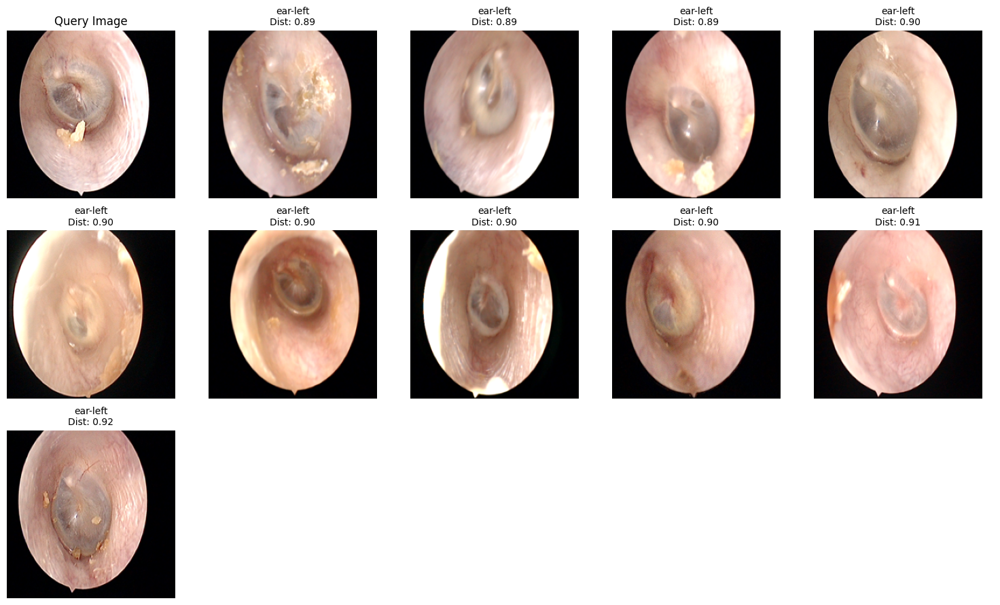

train/train/imgs/73caa520-6eda-4f67-a097-43a0bf6ce443.png vc-open
                                                Path Predicted_Fine  \
0  train/train/imgs/ddd5fe50-f62d-463f-8523-e640e...        vc-open   
1  train/train/imgs/313c0ce6-cf8c-4956-8cb9-2298a...        vc-open   
2  train/train/imgs/b704f9f3-18b7-46c7-83fb-1ba0a...        vc-open   
3  train/train/imgs/fe340261-ee33-48b6-9585-1d44d...        vc-open   
4  train/train/imgs/ee59642b-67e1-4f2e-9cec-45a01...        vc-open   
5  train/train/imgs/38becbed-eb33-4a79-bd72-f23d2...        vc-open   
6  train/train/imgs/519ea1e7-363e-4af8-8bb9-5954f...        vc-open   
7  train/train/imgs/3329eba9-0795-4b8e-99c8-1b1b4...        vc-open   
8  train/train/imgs/89cd570b-016b-46dc-9e80-b7d40...        vc-open   
9  train/train/imgs/c19e2177-3158-4dd7-bdf6-65c67...        vc-open   

  Classification  Distance  
0        vc-open  0.965813  
1        vc-open  0.966804  
2        vc-open  0.966967  
3        vc-open  0.968097  
4      

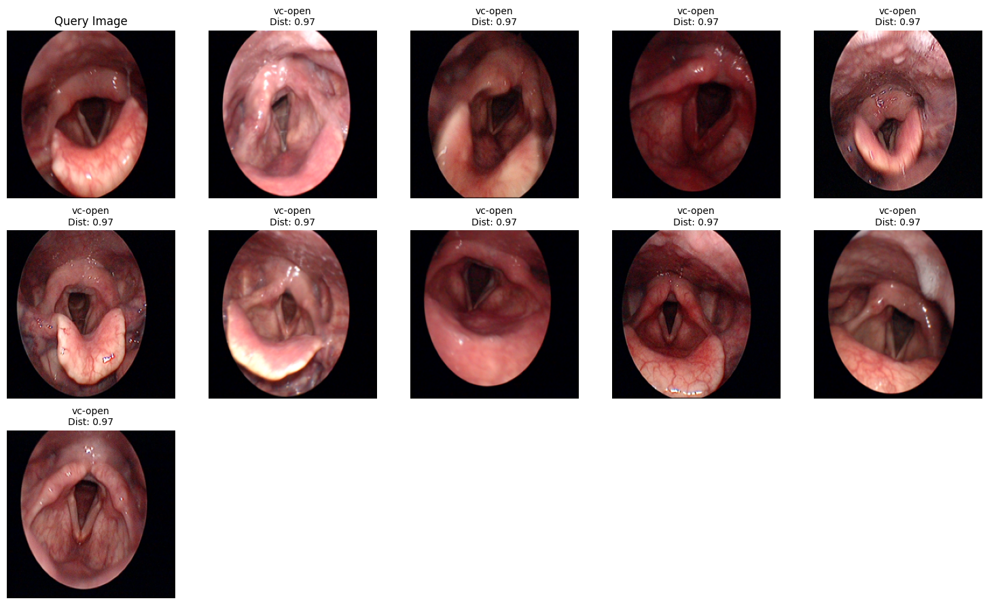

train/train/imgs/fd2f16e1-750e-4e61-8118-1039f1e9c1ec.png nose-left
                                                Path Predicted_Fine  \
0  train/train/imgs/a162a4dc-0223-4bad-88d0-c33c6...      nose-left   
1  train/train/imgs/369e8191-3a11-41df-8955-4105e...      nose-left   
2  train/train/imgs/e3790e42-2964-4660-b28e-0dba5...      nose-left   
3  train/train/imgs/7224a156-fd7f-41bd-b63d-f619c...      nose-left   
4  train/train/imgs/d17f2fbd-e868-43dd-a837-87ba5...      nose-left   
5  train/train/imgs/bf7ac661-1fd9-4740-b42a-ca9a6...      nose-left   
6  train/train/imgs/05e51399-1b47-4c84-905f-243b9...      nose-left   
8  train/train/imgs/33813193-2b37-4327-a62b-99f74...      nose-left   
9  train/train/imgs/a270c51c-152a-4c38-a222-ad32b...      nose-left   

  Classification  Distance  
0      nose-left  0.931971  
1      nose-left  0.932387  
2      nose-left  0.932715  
3      nose-left  0.935202  
4      nose-left  0.939409  
5      nose-left  0.946501  
6      nose-left  

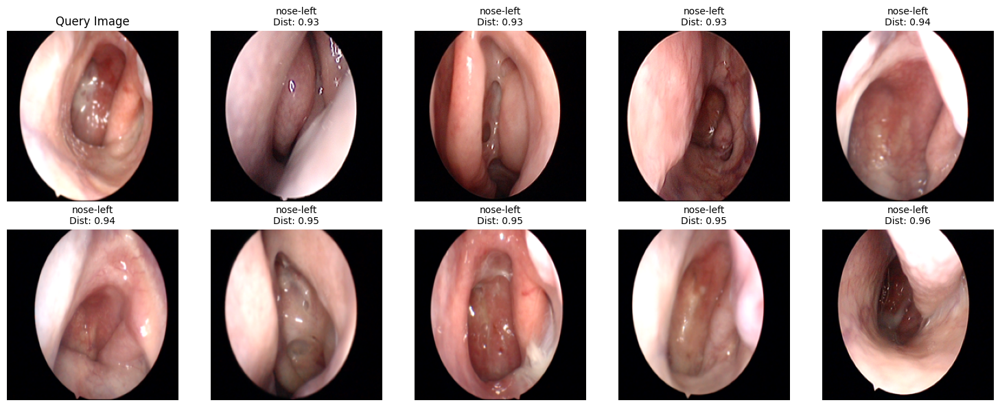

Dataset/images/19011685_231003082551039831_954_Image05.png nose-left
                                                Path Predicted_Fine  \
1  train/train/imgs/7224a156-fd7f-41bd-b63d-f619c...      nose-left   
2  train/train/imgs/1974f229-ab50-4699-8241-5ff36...      nose-left   
4  train/train/imgs/f7da18a1-1a30-4aec-a6ef-6a554...      nose-left   
5  train/train/imgs/92931d99-13cc-46f2-9efd-7b653...      nose-left   
6  train/train/imgs/ceebc0f8-3523-460f-9ebe-72dd6...      nose-left   
8  train/train/imgs/8c11f49b-f728-4006-95fc-bea33...      nose-left   
9  train/train/imgs/136cfd15-a10e-4d6f-ab6d-83d97...      nose-left   

  Classification  Distance  
1      nose-left  0.911442  
2      nose-left  0.914113  
4      nose-left  0.915054  
5      nose-left  0.917730  
6      nose-left  0.918341  
8      nose-left  0.926386  
9      nose-left  0.984939  


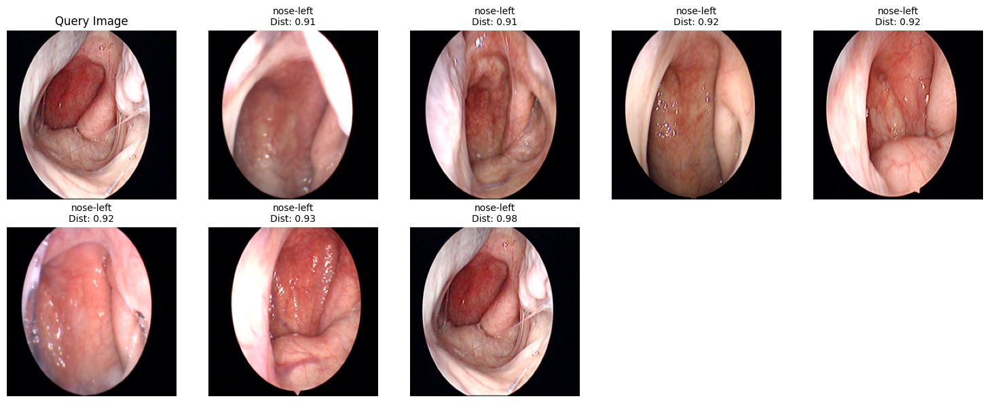

Dataset/images/19086309_231023093006012831_954_Image08.png nose-left
                                                Path Predicted_Fine  \
0  train/train/imgs/75a75347-b4f4-4d52-85cb-9a8d5...     nose-right   
1  train/train/imgs/cf4639bd-71ec-4879-806b-87868...     nose-right   
2  train/train/imgs/9050e154-0e8a-4c2b-afce-72a21...     nose-right   
5  train/train/imgs/028387f6-f419-46f1-9a6a-e88e4...     nose-right   
8  train/train/imgs/a90580ef-0071-4997-a0ed-e6d44...     nose-right   
9  train/train/imgs/5cd0c06f-58c6-4694-8e55-edaa5...     nose-right   

  Classification  Distance  
0      nose-left  0.926893  
1     nose-right  0.927101  
2     nose-right  0.927167  
5     nose-right  0.929522  
8     nose-right  0.931163  
9     nose-right  0.937499  


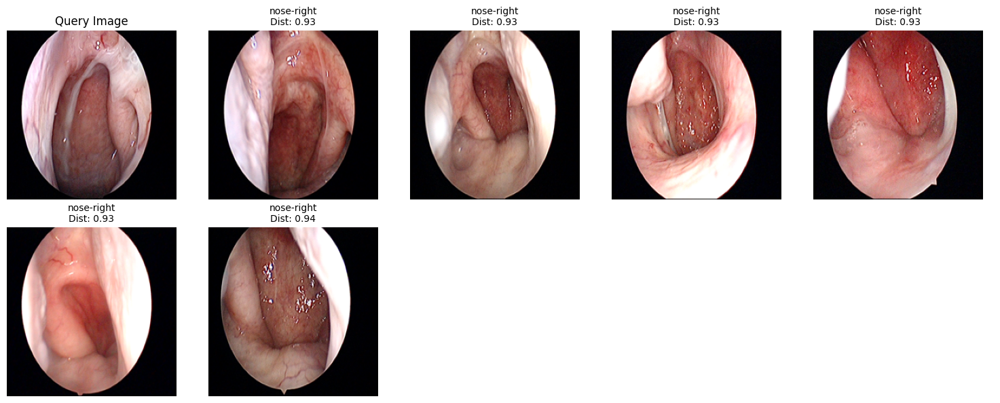

In [60]:
for i in range(5):
    query_row = df_test.iloc[i]  # arbitrary query image
    print(query_row['Path'], query_row['Classification'])
    similar_images_df = clf.image_to_image_train_search(query_row, top_k=25)
    similar_images_df = similar_images_df[
        (similar_images_df['Path'].str.startswith("train/train")) & 
        (similar_images_df['Distance'] > 0)
    ].head(10)
    print(similar_images_df[["Path", "Predicted_Fine", "Classification", "Distance"]])
    
    plot_similar_images(
        query_row=query_row,
        similar_images_df=similar_images_df,
        images_base_path=DATA_PATH
    )

In [61]:
import matplotlib.pyplot as plt
from PIL import Image
import os

def plot_text_queried_images(query_text, similar_images_df, images_base_path, n_cols=5, image_size=(224, 224)):
    """
    Plots the query text and its top-K similar images from similar_images_df.
    Handles empty DataFrame gracefully.
    """
    if similar_images_df.empty:
        # If empty, just show a message with the query text
        fig, ax = plt.subplots(figsize=(6, 2))
        ax.text(0.5, 0.5, f"No similar images found for query:\n'{query_text}'",
                ha='center', va='center', fontsize=12)
        ax.axis("off")
        plt.tight_layout()
        plt.show()
        return

    n_images = len(similar_images_df)
    n_rows = (n_images + n_cols - 1) // n_cols

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3 * n_rows))
    axes = axes.flatten()

    fig.suptitle(f"Query: {query_text}", fontsize=14, y=1.02)

    for i, (_, row) in enumerate(similar_images_df.iterrows()):
        img_path = os.path.join(images_base_path, row['Path'])
        img = Image.open(img_path).convert("RGB").resize(image_size)

        label = row.get("Classification", row.get("Predicted_Fine", row.get("Predicted_Coarse", "Unknown")))

        axes[i].imshow(img)
        axes[i].set_title(f"{label}\nDist: {row['Distance']:.2f}", fontsize=10)
        axes[i].axis("off")

    for j in range(n_images, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.subplots_adjust(top=0.92)
    plt.show()

In [62]:
from tqdm import tqdm

recall_at_1_list = []
recall_at_5_list = []
recall_at_10_list = []

df_with_description = df_combined[df_combined['DescriptionEN'].notna()]
df_sample_train = df_with_description.sample(n=len(df_test), random_state=42).reset_index(drop=True)

for i in tqdm(range(30)):
    query_row = df_sample_train.iloc[i]
    query_class = query_row['Coarse_Classification']

    # Top-k image retrieval using text query
    similar_images_df = clf.text_to_image_train_search(query_row['DescriptionEN'], top_k=25)
    similar_images_df = similar_images_df[similar_images_df['Distance'] > 0].head(10)

    n_class_train = (clf.train_df["Coarse_Classification"] == query_class).sum()

    # Recall@1
    denom_1 = min(1, n_class_train)
    retrieved_correct_1 = int(similar_images_df.iloc[:1]["Coarse_Classification"].eq(query_class).sum())
    recall_at_1 = retrieved_correct_1 / denom_1 if denom_1 > 0 else 0.0
    recall_at_1_list.append(recall_at_1)

    # Recall@5
    denom_5 = min(5, n_class_train)
    retrieved_correct_5 = similar_images_df.iloc[:5]["Coarse_Classification"].eq(query_class).sum()
    recall_at_5 = retrieved_correct_5 / denom_5 if denom_5 > 0 else 0.0
    recall_at_5_list.append(recall_at_5)

    # Recall@10
    denom_10 = min(10, n_class_train)
    retrieved_correct_10 = similar_images_df.iloc[:10]["Coarse_Classification"].eq(query_class).sum()
    recall_at_10 = retrieved_correct_10 / denom_10 if denom_10 > 0 else 0.0
    recall_at_10_list.append(recall_at_10)

# Print average recalls
print("Text-Image Retrieval")
print(f"\nRecall@1  over {len(df_sample_train)} queries: {sum(recall_at_1_list)/len(recall_at_1_list):.4f}")
print(f"Recall@5  over {len(df_sample_train)} queries: {sum(recall_at_5_list)/len(recall_at_5_list):.4f}")
print(f"Recall@10 over {len(df_sample_train)} queries: {sum(recall_at_10_list)/len(recall_at_10_list):.4f}")

100%|██████████| 30/30 [00:53<00:00,  1.78s/it]

Text-Image Retrieval

Recall@1  over 186 queries: 0.8000
Recall@5  over 186 queries: 0.7800
Recall@10 over 186 queries: 0.7900


Dataset/images/17105545_230928084836926831_121_Image04.png ear-left
the external auditory canal is slightly edematous
the tympanic membrane is intact but thickened, the cone of light is not visualized 
Found original image at rank 0 in the results.
                                                Path Predicted_Coarse  \
0  Dataset/images/13140140_240104093719027831_954...              ear   
1  Dataset/images/17092118_231121081438130831_954...              ear   
2  train/train/imgs/9a299ef6-39e7-410c-92cb-37f95...              ear   
3  Dataset/images/15023886_230828083920833831_121...              ear   
4  train/train/imgs/7e2fc64b-4abe-414c-b4a3-45852...              ear   
5  Dataset/images/19076970_231207092848905831_121...              ear   
6  train/train/imgs/5cf445ea-660e-43ad-87d1-e27ed...              ear   
7  Dataset/images/22111085_230410093848009831_121...              ear   
8  train/train/imgs/b46970f1-d4d7-430e-983f-1773d...              ear   
9  train/train/imgs/1

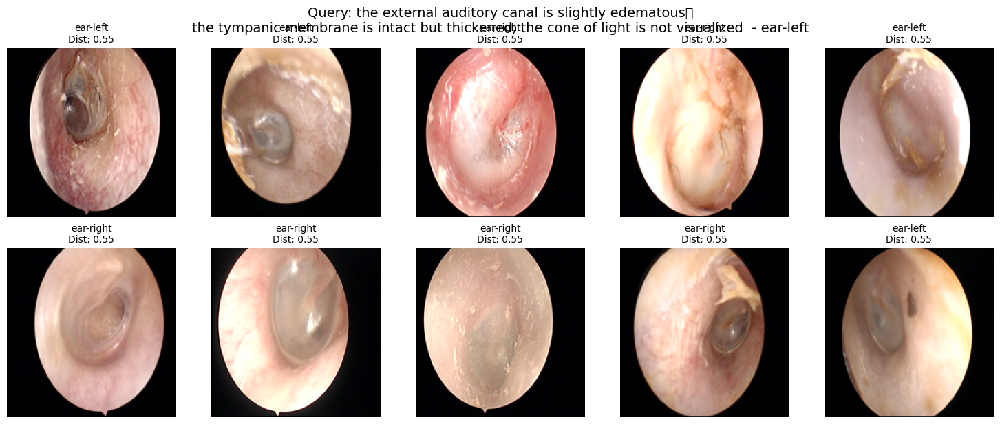

Dataset/images/19011685_231006094617286831_954_Image05.png vc-open
edema of the arytenoid cartilages
the vocal cords are edematous and erythematous
Found original image at rank 0 in the results.
                                                Path Predicted_Coarse  \
0  Dataset/images/19085102_230905135518413831_954...               vc   
1  Dataset/images/15008623_231016105506914831_954...               vc   
2  Dataset/images/16150712_231116104929033831_954...               vc   
3  Dataset/images/20072280_230615151513751831_954...               vc   
4  Dataset/images/23081629_230407095937623831_121...               vc   
5  Dataset/images/15005848_230714150145303831_954...               vc   
6  Dataset/images/13140140_241001094445032831_954...               vc   
7  Dataset/images/22080705_230530105122327831_954...               vc   
8  Dataset/images/13144258_240219083840316831_121...               vc   
9  Dataset/images/17097111_231004093806111831_954...               vc   

 

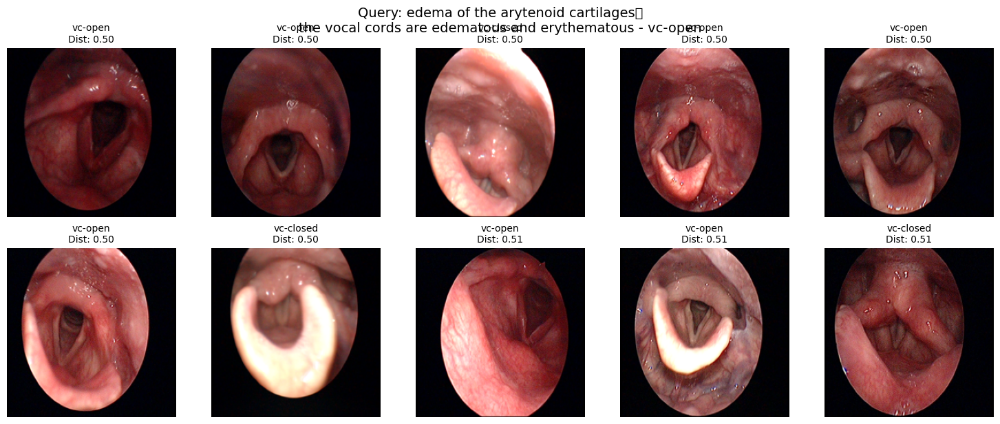

Dataset/images/13140140_241001094445032831_954_Image02.png vc-closed
edema of the arytenoid
omega-shaped epiglottis
Found original image at rank 0 in the results.
                                                Path Predicted_Coarse  \
0  Dataset/images/20064902_230919090142300831_954...               vc   
1  train/train/imgs/ad09ef49-ed8a-4aba-97d4-4c83c...               vc   
2  Dataset/images/15005848_230714150145303831_954...               vc   
3  Dataset/images/17095233_231107081405390831_954...               vc   
4  Dataset/images/23079204_230801085033209831_954...               vc   
5  Dataset/images/13138867_240704080331798831_954...               vc   
6  Dataset/images/13140140_241001094445032831_954...               vc   
7  Dataset/images/15008623_231016105506914831_954...               vc   
8  Dataset/images/15004709_231206082905713831_954...               vc   
9  Dataset/images/23925463_231024085805648831_954...               vc   

  Classification  Distance  
0   

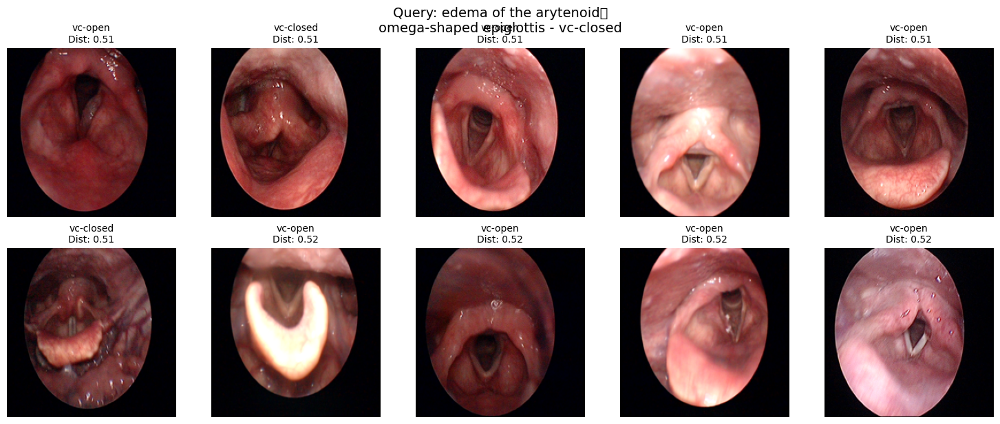

Dataset/images/22043263_230620084759579831_121_Image06.png nose-right
edema and erythema of the nasopharynx
presence of nasal watery discharge
Found original image at rank 0 in the results.
                                                Path Predicted_Coarse  \
0  Dataset/images/13142046_240610084817440831_121...             nose   
1  Dataset/images/16146146_230410085218629831_121...             nose   
2  Dataset/images/17095516_230927105314719831_954...             nose   
3  Dataset/images/23922415_230626075146250831_954...             nose   
4  Dataset/images/13142046_240610084817440831_121...             nose   
5  Dataset/images/19086309_231011144424243831_954...             nose   
6  Dataset/images/17102052_230922081743225831_954...             nose   
7  Dataset/images/19091014_231219095603849831_954...             nose   
8  Dataset/images/16146146_230410085218629831_121...             nose   
9  Dataset/images/17097561_230921074417169831_949...             nose   

  Clas

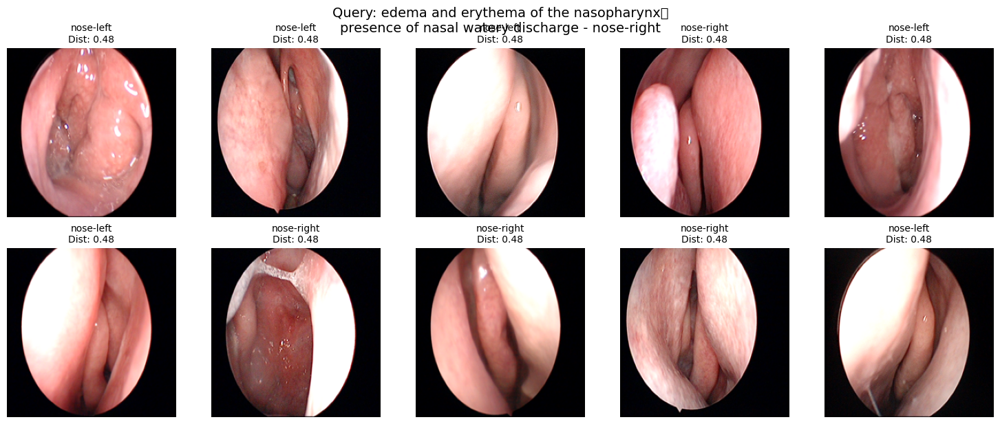

Dataset/images/22051991_231101105007620831_954_Image03.png nose-right
erythema of the nasopharynx
whitish mucus on the nasopharynx
Found original image at rank 0 in the results.
                                                Path Predicted_Coarse  \
0  train/train/imgs/c2e47496-523d-4dcf-a0fa-1db09...             nose   
1  Dataset/images/22099094_230822104055146831_121...             nose   
2  Dataset/images/13142046_240610084817440831_121...             nose   
3  Dataset/images/23144375_230622085729593831_121...             nose   
4  Dataset/images/13148338_240906134649350831_121...             nose   
5  Dataset/images/16151534_230713092020564831_954...             nose   
6  train/train/imgs/a4f02d19-00c2-4a86-858c-5e5dc...             nose   
7  Dataset/images/23149901_230718075102304831_954...             nose   
8  train/train/imgs/8808d64c-fc89-41f6-9ec1-85e7e...             nose   
9  Dataset/images/19011685_231003082551039831_954...             nose   

  Classification  

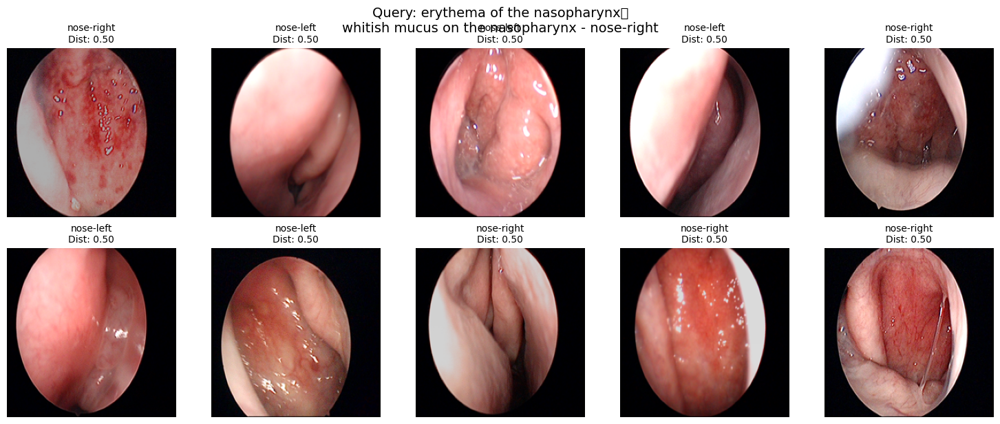

In [63]:
for i in range(5):
    query_row = df_sample_train.iloc[i]  # arbitrary query image
    print(query_row['Path'], query_row['Classification'])
    print(query_row['DescriptionEN'])

    # Search similar images
    similar_images_df = clf.text_to_image_train_search(query_row['DescriptionEN'], top_k=50)
    similar_images_df = similar_images_df[similar_images_df['Distance'] > 0][:10]

    # Find position of the original image in the top-k results
    match_indices = similar_images_df.index[similar_images_df['Coarse_Classification'] == query_row['Coarse_Classification']].tolist()
    if match_indices:
        position = match_indices[0]  # rank is 1-based
        print(f"Found original image at rank {position} in the results.")
    else:
        print("Original image not found in top-10 results.")

    # Show results
    print(similar_images_df[["Path", "Predicted_Coarse", "Classification", "Distance"]])

    # Plot results
    plot_text_queried_images(
        query_text=query_row['DescriptionEN'] + " - " + query_row['Classification'],
        similar_images_df=similar_images_df,
        images_base_path=DATA_PATH
    )

In [64]:
# # Train-time prototype generation
# print("🔍 Generating prototypes...")
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# model, _, preprocess = open_clip.create_model_and_transforms("hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224")
# tokenizer = open_clip.get_tokenizer("hf-hub:microsoft/BiomedCLIP-PubMedBERT_256-vit_base_patch16_224")
# model = model.to(device).eval()

# def embed_train(row):
#     path = os.path.join(DATA_PATH, row["Path"])
#     img = preprocess(Image.open(path).convert("RGB")).unsqueeze(0).to(device)
#     text = row["DescriptionEN"] if isinstance(row["DescriptionEN"], str) else ""
#     text_tokens = tokenizer([text]).to(device)
#     with torch.no_grad(), torch.cuda.amp.autocast():
#         img_emb = model.encode_image(img)
#         txt_emb = model.encode_text(text_tokens)
#     sim = torch.nn.functional.cosine_similarity(img_emb, txt_emb, dim=1)
#     combined = img_emb * sim.unsqueeze(1) + txt_emb * (1 - sim.unsqueeze(1))
#     return combined.squeeze(0).cpu().numpy()

# protos = defaultdict(list)
# for _, row in tqdm(df.iterrows(), total=len(df)):
#     protos[row["Coarse_Classification"]].append(embed_train(row))

# class_names = sorted(protos)
# proto_mat = np.vstack([np.mean(protos[c], axis=0) for c in class_names]).astype('float32')
# faiss.normalize_L2(proto_mat)
# index = faiss.IndexFlatIP(proto_mat.shape[1])
# index.add(proto_mat)
# faiss.write_index(index, "prototypes.index")

# # Compute and store all image embeddings in df_train
# print("🔍 Embedding training images for FAISS index...")

# df["ImageEmbedding"] = df.apply(embed_train, axis=1)

# # Build FAISS index from training image embeddings
# print("🔧 Building FAISS index for training images...")

# train_embeddings = np.vstack(df["ImageEmbedding"].values).astype("float32")
# faiss.normalize_L2(train_embeddings)

# train_index = faiss.IndexFlatIP(train_embeddings.shape[1])
# train_index.add(train_embeddings)
# faiss.write_index(train_index, "train_images.index")

# # Load binary classifiers
# binary_models = {
#     "full": torch.load("full_model.pt", map_location=device, weights_only=False),
#     "ear": torch.load("ear_model.pt", map_location=device, weights_only=False),
#     "nose": torch.load("nose_model.pt", map_location=device, weights_only=False),
#     "vc": torch.load("vc_model.pt", map_location=device, weights_only=False)
# }

# clf = BiomedCLIPClassifier(
#     image_dir=DATA_PATH,
#     prototype_index_path="prototypes.index",
#     prototype_class_names=class_names,
#     binary_models=binary_models,
#     train_index_path="train_images.index",
#     train_df=df,
#     use_text=True
# )

In [65]:
# import os
# import json

# df_sub = pd.DataFrame(columns=df_1.columns)
# df_track1 = pd.read_csv(os.path.join(DATA_PATH, "ENTRep_Track1_Private_Data", "cls.csv"), header=None)
# track1_images = df_track1[0].tolist()
# df_sub['Path'] = track1_images
# df_sub['Path'] = df_sub['Path'].apply(lambda x: os.path.join("ENTRep_Private_Dataset_Update/imgs", x))

# df_sub["Classification"] = df_sub.apply(lambda row: clf.classify(row)[1], axis=1)

# df_sub["Label"] = df_sub["Classification"].map(class_to_label)

# # Extract just the filename from the path
# filenames = df_sub['Path'].apply(os.path.basename)

# # Create mapping: filename → label
# path_to_class = dict(zip(filenames, df_sub['Label']))

# # Save to JSON
# with open("submission.json", "w") as f:
#     json.dump(path_to_class, f, indent=2)

# print(list(path_to_class.items())[:5])

In [66]:
# df_sub = pd.DataFrame(columns=df_1.columns)
# df_track2 = pd.read_csv(os.path.join(DATA_PATH, "ENTRep_Track2_Private_Data", "i2i.csv"), header=None)
# track2_images = df_track2[0].tolist()
# df_sub['Path'] = track2_images
# df_sub['Path'] = df_sub['Path'].apply(lambda x: os.path.join("ENTRep_Private_Dataset_Update/imgs", x))

# df_sub["Classification"] = df_sub.apply(lambda row: clf.classify(row)[1], axis=1)

# df_sub["Label"] = df_sub["Classification"].map(class_to_label)

# # df_sub['DescriptionEN'] = df_sub.apply(
# #     lambda row: row['DescriptionEN'] if pd.notnull(row['DescriptionEN']) else fallback_descriptions.get(row['Classification'], None),
# #     axis=1
# # )

# i2i_sub = {}
# unmatched_count = 0

# for i in tqdm(range(len(df_sub))):

#     query_row = df_sub.iloc[i]
#     similar_images_df = clf.image_to_image_train_search(query_row, top_k=25)

#     # Filter and get first matching row
#     row = similar_images_df[
#         (similar_images_df['Path'].str.startswith("train/train")) &
#         (similar_images_df['Distance'] > 0)
#     ].head(1)

#     if not row.empty:
#         query_filename = os.path.basename(query_row['Path'])
#         match_filename = os.path.basename(row.iloc[0]['Path'])
#         i2i_sub[query_filename] = match_filename
#     else:
#         unmatched_count += 1
#         print(f"Warning, no match found for row {i} (unmatched count: {unmatched_count})")

# with open("submission_i2i.json", "w") as f:
#     json.dump(i2i_sub, f, indent=2)

# print(list(i2i_sub.items())[:5])

In [67]:
# df_sub = pd.DataFrame(columns=df_1.columns)
# df_track3 = pd.read_csv(os.path.join(DATA_PATH, "ENTRep_Track3_Private_Data", "t2i.csv"), header=None)
# track3_texts = df_track3[0].tolist()
# df_sub['DescriptionEN'] = track3_texts

# t2i_sub = {}
# unmatched_count = 0

# for i in tqdm(range(len(df_sub))):
#     query_row = df_sub.iloc[i]
#     query = query_row['DescriptionEN']
#     similar_images_df = clf.text_to_image_train_search(query, top_k=50)

#     # Filter and get first matching row
#     row = similar_images_df[
#         (similar_images_df['Path'].str.startswith("train/train")) &
#         (similar_images_df['Distance'] > 0)
#     ].head(1)

#     if not row.empty:
#         match_filename = os.path.basename(row.iloc[0]['Path'])
#         t2i_sub[query] = match_filename
#     else:
#         unmatched_count += 1
#         print(f"Warning, no match found for row {i} (unmatched count: {unmatched_count})")

# with open("submission_t2i.json", "w") as f:
#     json.dump(t2i_sub, f, indent=2)

# print(list(t2i_sub.items())[:5])